# Police Fatalities in the US From 2000 To 2020

Data obtained from Kaggle: https://www.kaggle.com/datasets/djonafegnem/police-fatalities-in-the-us-from-2000-to-2020

GitHub link: https://github.com/samantharivas/Police_Fatalities.git

## Import Libaries

In [1]:
# import appropriate packages 
import pandas as pd
import numpy as np
import seaborn as sns

import dmba
from dmba import regressionSummary, gainsChart, liftChart
from dmba import adjusted_r2_score, AIC_score, BIC_score

from sklearn.model_selection import GridSearchCV

from sklearn.metrics import confusion_matrix, accuracy_score, ConfusionMatrixDisplay, classification_report, f1_score
from sklearn.metrics import roc_auc_score, roc_curve
from scikitplot.metrics import plot_cumulative_gain
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.preprocessing import OneHotEncoder
from sklearn.impute import SimpleImputer
from imblearn.over_sampling import SMOTE

from statsmodels.stats.outliers_influence import variance_inflation_factor

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_selection import SelectKBest, chi2, f_classif
from sklearn.linear_model import Perceptron, LogisticRegression

import scipy.stats as stats
from scipy.stats import chi2_contingency

import folium

from sklearn.naive_bayes import GaussianNB
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn import tree 
from sklearn.tree import plot_tree 

from sklearn.inspection import permutation_importance

from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import GridSearchCV
import scikitplot as skplt



import os

%matplotlib inline
import matplotlib.pylab as plt
import matplotlib 
import matplotlib.ticker as mticker

import warnings
warnings.filterwarnings("ignore") #supress warnings

no display found. Using non-interactive Agg backend


## Import Dataset

In [2]:
# download datset from Kaggle
police_df = pd.read_csv('police_fatalities.csv') # read csv file 

# rename columns by replacing spaces with underscores
police_df.columns = police_df.columns.str.replace(' ', '_')

# replace single quotes with an empty string in column names
police_df.columns = police_df.columns.str.replace("'", "")

In [3]:
# print 10 random samples from the dataframe 
police_df.sample(10)

,Unique_ID,Subjects_name,Subjects_age,Subjects_gender,Subjects_race,Subjects_race_with_imputations,Imputation_probability,URL_of_image_of_deceased,Date_of_injury_resulting_in_death_(month/day/year),Location_of_injury_(address),...,A_brief_description_of_the_circumstances_surrounding_the_death,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Intentional_Use_of_Force_(Developing),Link_to_news_article_or_photo_of_official_document,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Video,Date&Description,Unique_ID_formula,Unique_identifier_(redundant),Date_(Year)
25952,25797,Brandon Michael Jacque,25,Male,European-American/White,European-American/White,not imputed,https://www.fatalencounters.org/wp-content/upl...,03/27/2019,McNeil St and E League St,...,An officer responded for a complaint about lou...,Pending investigation,"Intentional Use of Force, Deadly",https://www.kxan.com/news/local-news/burnet-ma...,No,NaN,3/27/2019: An officer responded for a complain...,NaN,25797.0,2019.0
14733,22071,Laporsha R. Watson,27,Female,African-American/Black,African-American/Black,not imputed,https://www.fatalencounters.org/wp-content/upl...,09/03/2012,Eighth Street & I-95,...,Watson was struck by a patrol car driven by Lt...,Unreported,Vehicle/Pursuit,http://jacksonville.com/news/crime/2012-09-03/...,No,NaN,9/3/2012: Watson was struck by a patrol car dr...,NaN,22071.0,2012.0
12231,20588,Elaine Joyce Veres,54,Female,Race unspecified,European-American/White,0.982924735,NaN,12/15/2010,99 Water Street,...,"Shaun Veres killed his mother, Elaine Joyce Ve...",Murder/suicide,"Intentional Use of Force, Deadly",http://triblive.com/x/pittsburghtrib/news/regi...,No,NaN,"12/15/2010: Shaun Veres killed his mother, Ela...",NaN,20588.0,2010.0
8851,7029,Shannon Patrick Casey,36,Male,Race unspecified,European-American/White,0.910884408,NaN,04/01/2008,Sutterville Road,...,Shannon Patrick Casey drowned after the pickup...,Unreported,No,https://drive.google.com/file/d/0B62PuBu1vKRLY...,Unknown,NaN,4/1/2008: Shannon Patrick Casey drowned after ...,NaN,7029.0,2008.0
12090,9595,Nathaniel William Henry,41,Male,European-American/White,European-American/White,not imputed,http://www.vote29.com/newmyblog/wp-content/upl...,11/04/2010,7600 block Camp Rock Road,...,Detectives shot and killed Nathaniel William H...,Justified,"Intentional Use of Force, Deadly",http://www.sbsun.com/article/ZZ/20101105/NEWS/...,No,NaN,11/4/2010: Detectives shot and killed Nathanie...,NaN,9595.0,2010.0
8798,6989,Johnny Anthony Hooper,34,Male,African-American/Black,African-American/Black,not imputed,https://fatalencounters.org/wp-content/uploads...,03/15/2008,1053 SE Ave A,...,Hooper drove through a traffic stop. Fisher Co...,Unreported,Yes,https://drive.google.com/open?id=0B_YUrB_q0WyC...,No,NaN,3/15/2008: Hooper drove through a traffic stop...,NaN,6989.0,2008.0
14735,11782,Christopher Boone Lacy,36,Male,European-American/White,European-American/White,not imputed,http://www.ksbw.com/image/view/-/16493470/high...,09/04/2012,Livorna Rd & I-680,...,Investigators seeking answers about Lacy's men...,Justified,"Intentional Use of Force, Deadly",http://www.contracostatimes.com/ci_22844243/re...,Yes,NaN,9/4/2012: Investigators seeking answers about ...,NaN,11782.0,2012.0
13269,10543,Sean Edward Ogle,32,Male,African-American/Black,African-American/Black,not imputed,NaN,09/06/2011,2546 24th Street,...,Ogle was smashing in store windows with a base...,Justified,"Intentional Use of Force, Deadly",http://christianpeet.com/2011/10/mentally-ill-...,Yes,NaN,9/6/2011: Ogle was smashing in store windows w...,NaN,10543.0,2011.0
21038,17792,Nicholas Damon,30,Male,Hispanic/Latino,Hispanic/Latino,not imputed,https://fatalencounters.org/wp-content/uploads...,06/16/2016,8601 Sheridan Blvd,...,Officers were in the parking lot of a Guitar C...,Pending investigation,"Intentional Use of Force, Deadly",http://www.9news.com/news/crime/suspect-dead-a...,No,NaN,6/16/2016: Officers were in the parking lot of...

## Data Inspection

In [4]:
police_df.shape # df contains 28335 rows of data (records) and 29 columns (features)

(28335, 29)

In [5]:
police_df.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28335 entries, 0 to 28334
Data columns (total 29 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   Unique_ID                                                       28334 non-null  object 
 1   Subjects_name                                                   28335 non-null  object 
 2   Subjects_age                                                    27354 non-null  object 
 3   Subjects_gender                                                 28237 non-null  object 
 4   Subjects_race                                                   28334 non-null  object 
 5   Subjects_race_with_imputations                                  27905 non-null  object 
 6   Imputation_probability                                          27897 non-null  object 
 7   URL_of_image_of_deceased                         

The data frame contains numerous null values and includes both object and numerical data types. It seems that some of the numeric values are categorized as 'object'; these will be converted to their appropriate numeric data type. The

In [6]:
# convert columns which contain numerical values into numeric data type 

columns_to_convert = ['Subjects_age', 'Latitude', 'Longitude','Location_of_death_(zip_code)', 
                      'Imputation_probability','Unique_identifier_(redundant)', 'Date_(Year)']

# iterate through a list, using 'pd.to_numeric' to convert data within columns_to_convert to numeric data types
for col in columns_to_convert:
    police_df[col] = pd.to_numeric(police_df[col], errors='coerce') #coversion errors displayed as NaN
    
police_df.info() #check data type after conversion 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28335 entries, 0 to 28334
Data columns (total 29 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   Unique_ID                                                       28334 non-null  object 
 1   Subjects_name                                                   28335 non-null  object 
 2   Subjects_age                                                    27294 non-null  float64
 3   Subjects_gender                                                 28237 non-null  object 
 4   Subjects_race                                                   28334 non-null  object 
 5   Subjects_race_with_imputations                                  27905 non-null  object 
 6   Imputation_probability                                          7029 non-null   float64
 7   URL_of_image_of_deceased                         

In [7]:
# convert the date column ('Date_of_injury_resulting_in_death') to a datetime format
police_df['Date_of_injury_resulting_in_death'] = pd.to_datetime(police_df['Date_of_injury_resulting_in_death_(month/day/year)'])

# extract month, day, and year and seperate them into separate columns
police_df['Injury_Month'] = police_df['Date_of_injury_resulting_in_death'].dt.month
police_df['Injury_Day'] = police_df['Date_of_injury_resulting_in_death'].dt.day
police_df['Injury_Year'] = police_df['Date_of_injury_resulting_in_death'].dt.year

In [8]:
police_df.columns # all column names within the new df w/extracted date componets 

Index(['Unique_ID', 'Subjects_name', 'Subjects_age', 'Subjects_gender',
       'Subjects_race', 'Subjects_race_with_imputations',
       'Imputation_probability', 'URL_of_image_of_deceased',
       'Date_of_injury_resulting_in_death_(month/day/year)',
       'Location_of_injury_(address)', 'Location_of_death_(city)',
       'Location_of_death_(state)', 'Location_of_death_(zip_code)',
       'Location_of_death_(county)', 'Full_Address', 'Latitude', 'Longitude',
       'Agency_responsible_for_death', 'Cause_of_death',
       'A_brief_description_of_the_circumstances_surrounding_the_death',
       'Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS',
       'Intentional_Use_of_Force_(Developing)',
       'Link_to_news_article_or_photo_of_official_document',
       'Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS', 'Video',
       'Date&Description', 'Unique_ID_formula',
       'Unique_identifier_(redundant)', 'Date_(Year)',
       'Date_of_injury_resulting_in_death', 'Injur

In [9]:
police_df.nunique() #number of unique values within each column 

Unique_ID                                                         28334
Subjects_name                                                     26982
Subjects_age                                                         97
Subjects_gender                                                       3
Subjects_race                                                         8
Subjects_race_with_imputations                                        9
Imputation_probability                                             6954
URL_of_image_of_deceased                                          12857
Date_of_injury_resulting_in_death_(month/day/year)                 7182
Location_of_injury_(address)                                      26026
Location_of_death_(city)                                           5940
Location_of_death_(state)                                            51
Location_of_death_(zip_code)                                      10460
Location_of_death_(county)                                      

From this, we can conclude that the df is highly diverse, a valuable aspect for analysis/investigation.  There are numerous unique values across different variables, the df reflects a rich source of information. 

In [10]:
police_df.kurtosis() # shape of distribution of numeric columns 

Subjects_age                     0.528233
Imputation_probability           0.079034
Location_of_death_(zip_code)    -1.272116
Latitude                         1.737740
Longitude                       -0.157605
Unique_ID_formula                     NaN
Unique_identifier_(redundant)   -1.200000
Date_(Year)                      0.842675
Injury_Month                    -1.167422
Injury_Day                      -1.192541
Injury_Year                      0.836232
dtype: float64

The statistics from kurtosis suggest that the dataset covers a wide range of ages, locations, and years, indicating the presence of imputed data. Latitude and longitude represent geographic coordinates, and Unique_ID_formula contains missing values.

## Exploratory Data Analysis

### Handling Missing Data 

In [11]:
#identify missing values in each column 
police_df.isnull().sum()  

Unique_ID                                                             1
Subjects_name                                                         0
Subjects_age                                                       1041
Subjects_gender                                                      98
Subjects_race                                                         1
Subjects_race_with_imputations                                      430
Imputation_probability                                            21306
URL_of_image_of_deceased                                          15424
Date_of_injury_resulting_in_death_(month/day/year)                    0
Location_of_injury_(address)                                        542
Location_of_death_(city)                                             36
Location_of_death_(state)                                             1
Location_of_death_(zip_code)                                        190
Location_of_death_(county)                                      

In [12]:
# calculate missing values as a percentage of total data 
missing_percentage = (police_df.isnull().sum() / len(police_df)) * 100 # convert to percentage 
missing_percentage = missing_percentage.sort_values(ascending=False) # place in ascending order

print('Missing Value Percentage per Column:')
print(missing_percentage)

Missing Value Percentage per Column:
Unique_ID_formula                                                 99.992942
Video                                                             99.989412
Imputation_probability                                            75.193224
URL_of_image_of_deceased                                          54.434445
Subjects_age                                                       3.673902
Location_of_injury_(address)                                       1.912829
Subjects_race_with_imputations                                     1.517558
Location_of_death_(zip_code)                                       0.670549
Subjects_gender                                                    0.345862
Agency_responsible_for_death                                       0.243515
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS         0.218811
Location_of_death_(city)                                           0.127051
Date&Description                                   

Columns with a significant portion of missing data (50% or more of their rows) will be dropped rather than imputed. This decision is made to ensure the integrity and reliability of the dataset.

In [13]:
# drop columns where more than 50% of the data is missing 

# identify and subset columns with more than 50% missing values
columns = missing_percentage[missing_percentage > 50]
columns_to_drop = missing_percentage[missing_percentage > 50].index

print('Columns with More than 50% Missing Values:')
print(columns)

Columns with More than 50% Missing Values:
Unique_ID_formula           99.992942
Video                       99.989412
Imputation_probability      75.193224
URL_of_image_of_deceased    54.434445
dtype: float64


In [14]:
# drop the identified columns with more than 50% missing values from the DataFrame
police_df.drop(columns=columns_to_drop, inplace=True)

Remaining of the missing values will be filled with the 'most frequent' value using a SimpleImputer.

In [15]:
# use SimpleImputer to replace the NaN values with the 'most frequent value '
imp = SimpleImputer(strategy = 'most_frequent')

In [16]:
# fit and transform the data replacing the NaN values of each feature with the
# 'most frequent' value of each feature
imputed_df = imp.fit_transform(police_df)

In [17]:
# obtain column names from original df
column_names = police_df.columns

# create a df from the imputed_data array using previous column names from police_df
imputed_df = pd.DataFrame(imputed_df, columns=column_names)

### Removing Duplicate Values

In [18]:
# identify number of duplicates in the df  
duplicates = imputed_df.duplicated()

# display rows with duplicates
duplicates = imputed_df.duplicated()
count_duplicates = duplicates.sum()
print("Count of Duplicate Rows:", count_duplicates)

Count of Duplicate Rows: 0


Data frame has zero duplicate values, thus all values remain. 

### Dropping Columns 

In [19]:
# drop redudant columns that will not be used for modeling 
imputed_df.drop(columns=['Unique_identifier_(redundant)', 'Link_to_news_article_or_photo_of_official_document', 
                        'Subjects_race_with_imputations', 'Subjects_name', 'Date&Description', 
                        'Full_Address', 'Date_(Year)', 'Date_of_injury_resulting_in_death', 'Injury_Day', 
                        'Date_of_injury_resulting_in_death_(month/day/year)'],inplace=True)

imputed_df.shape # dropping redundant columns the df consists of 19 variables and 28335 rows 

(28335, 19)

## Data Visualizations


#### Map Visualizations - Subset Dataset to California 

In [20]:
# create United States map to initialize subset of CA df 

# calculate the average latitude and longitude values 
average_latitude = imputed_df['Latitude'].mean()
average_longitude = imputed_df['Longitude'].mean()

# use the average coordinates as the center of the map 
latitude_center = average_latitude
longitude_center = average_longitude

# create United States map with incidents based on longitude and latitude values - sorted by gender 
us_map = folium.Map(location=[latitude_center, longitude_center], zoom_start=3)

# add markers for each location using latitude and longitude based on identified gender 
for index, row in imputed_df.iterrows():
    gender = row["Subjects_gender"]
    color = 'blue' if gender == 'Male' else 'red' if gender == 'Female' else 'gray' 

    # add marker for each location on the map (given by longitude and latitude coordinates), sorted by gender
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,  
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        tooltip=f"Gender: {gender}"
    ).add_to(us_map)

# display map
us_map

All data points from the dataframe were plotted on the map. From this visualization, it is evident that there are no outliers or points outside of the United States. Since our problem focuses on police fatalities within California, we will narrow down the dataset to include only longitude and latitude points within California.

In [21]:
# create subset df for California data points based on 'Location_of_death_(state)' column 
ca_df = imputed_df[imputed_df['Location_of_death_(state)'] == 'CA']

# drop location by state and zip code as they are deemed redundant (city and county are kept)
ca_df = ca_df.drop(columns=['Location_of_death_(state)', 'Location_of_death_(zip_code)'])

In [22]:
# convert columns which contain numerical values into numeric data type 
columns_to_convert = ['Subjects_age', 'Latitude', 'Longitude', 'Injury_Year', 'Injury_Month']

# iterate through  columns to convert them to numeric type with error handling
for col in columns_to_convert:
    ca_df[col] = pd.to_numeric(ca_df[col], errors='coerce')
    
ca_df.info() #check data type after conversion 

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4549 entries, 0 to 28334
Data columns (total 17 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   Unique_ID                                                       4549 non-null   object 
 1   Subjects_age                                                    4549 non-null   float64
 2   Subjects_gender                                                 4549 non-null   object 
 3   Subjects_race                                                   4549 non-null   object 
 4   Location_of_injury_(address)                                    4549 non-null   object 
 5   Location_of_death_(city)                                        4549 non-null   object 
 6   Location_of_death_(county)                                      4549 non-null   object 
 7   Latitude                                          

In [23]:
# create a map of Califronia incidents to identify potential outliers 

# calculate the average latitude and longitude values for positioning purpouses 
average_latitude = ca_df['Latitude'].mean()
average_longitude = ca_df['Longitude'].mean()

# use the average coordinates as the center
latitude_center = average_latitude
longitude_center = average_longitude

# create Folium map centered around California data 
ca_map = folium.Map(location=[latitude_center, longitude_center], zoom_start=5)

# add markers for each location using latitude and longitude based on identified gender 
for index, row in ca_df.iterrows():
    gender = row["Subjects_gender"]
    color = 'blue' if gender == 'Male' else 'red' if gender == 'Female' else 'gray' 
    
    # add marker for each location on the map (given by longitude and latitude coordinates), sorted by gender
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,  
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        tooltip=f"Gender: {gender}"
    ).add_to(ca_map)

# display map
ca_map

The map allows us to pinpoint outliers in the longitude and latitude data. These outliers will be excluded from the dataframe as they do not align with the problem statement.

#### Pair Plot

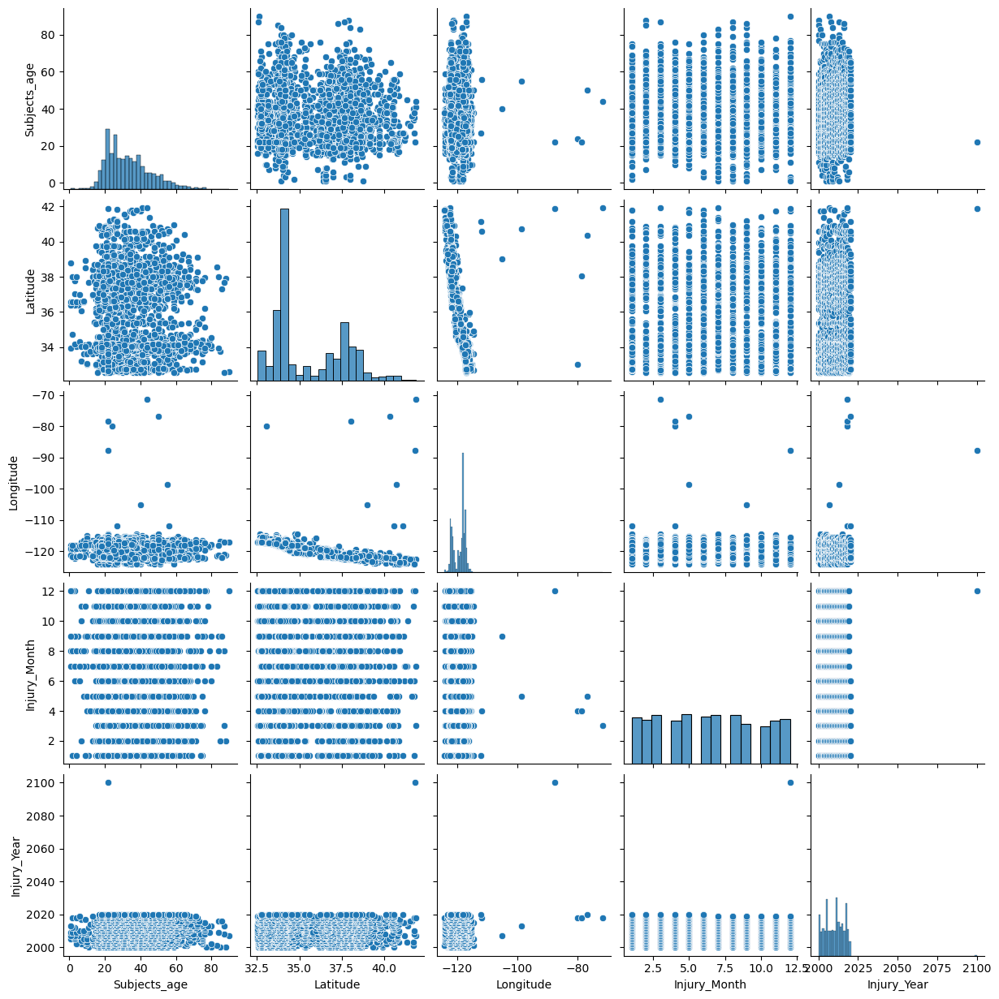

In [24]:
# reset the index to remove any duplicate labels (ensure enuique labels)
ca_df.reset_index(drop=True, inplace=True)

# create a pair plot to visualize relationships between numeric columns 
sns.pairplot(ca_df)
plt.show()

Pair plots serve as a tool for exploring the relationships between variables and identifying outliers. It is clear that there are outliers present in the following columns: Injury_Year, Subjects_age, Longitude, and Latitude. Further investigation into these outliers is warranted.

#### Box Plots

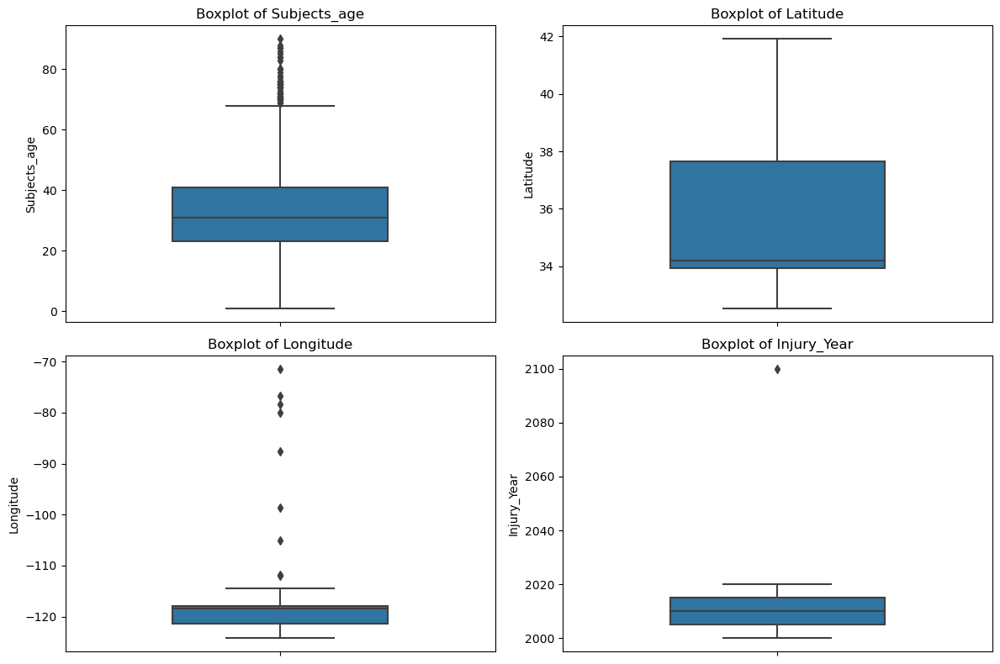

In [25]:
# List of numerical predictors to create boxplots 
predictors = ['Subjects_age', 'Latitude', 'Longitude', 'Injury_Year']

# create figure for boxplots subplots 
plt.figure(figsize=(12, 8))  

# create boxplots for each predictor
for i, predictor in enumerate(predictors):
    plt.subplot(2, 2, i + 1)  
    sns.boxplot(data=ca_df, y=predictor, width=0.5)
    plt.title(f'Boxplot of {predictor}')
    plt.ylabel(predictor)

plt.tight_layout()  
plt.show()

It seems that there is an outlier in the 'Injury_Year' column, which will be adjusted to display data collected only from 2000 to 2020. The year 2100, which appears to be a placeholder, will be excluded from the dataset.

#### Bar Plots

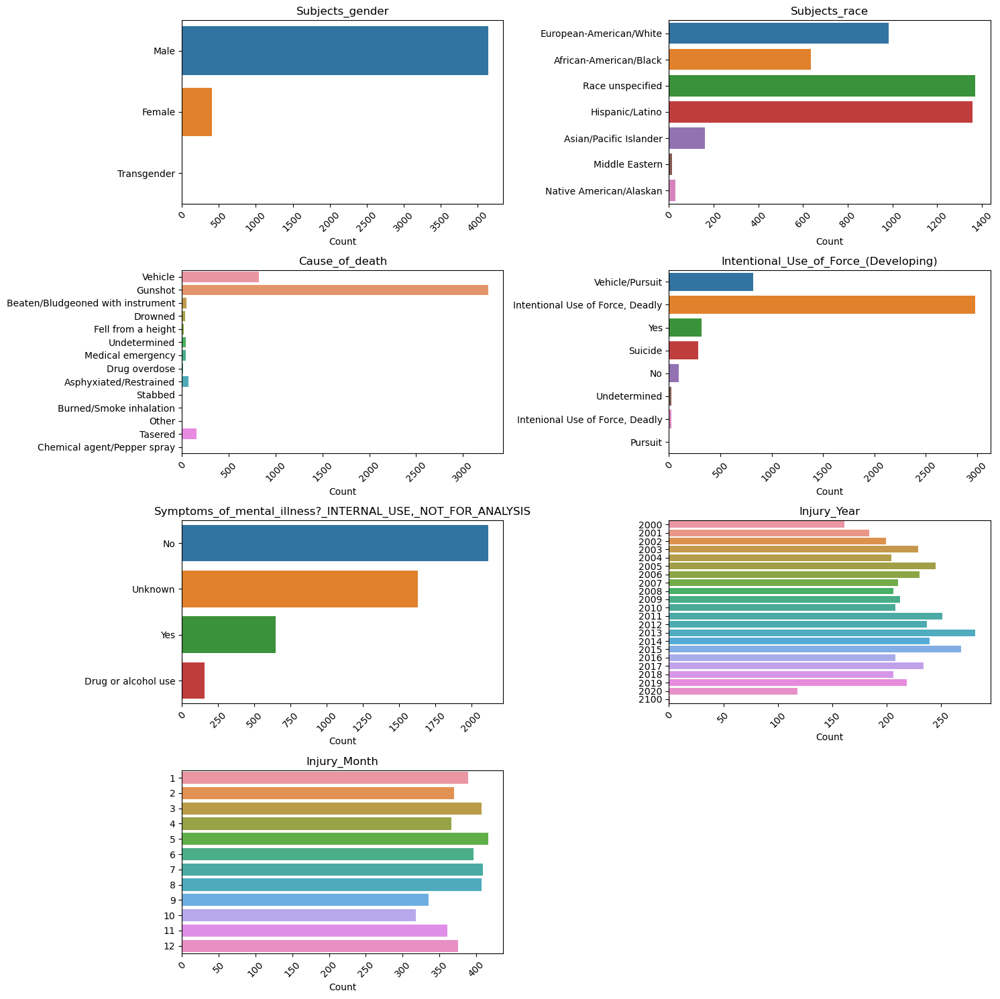

In [26]:
# list of selected columns for bar plot 
selected_columns =['Subjects_gender', 'Subjects_race', 'Cause_of_death', 'Intentional_Use_of_Force_(Developing)',
                   'Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS', 'Injury_Year', 'Injury_Month']

# calculate the number of rows and columns for the subplot grid
num_cols = 2
num_rows = (len(selected_columns) - 1) // num_cols + 1

# create subplots and flatten axis
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15))
axes = axes.flatten()

# iterate through selected columns and create horizontal countplots
for i, column in enumerate(selected_columns):
    sns.countplot(data=ca_df, y=column, ax=axes[i])
    axes[i].tick_params(axis='x', rotation=45)  

    axes[i].set_title(f'{column}')
    axes[i].set_xlabel('Count')
    axes[i].set_ylabel('')

# remove empty subplots
for i in range(len(selected_columns), num_rows * num_cols):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()

The barplots reveal the following insights: a significant proportion of the individuals are male, with an undisclosed racial background, and their fatalities result from intentional gunshot injuries. When examining the data by year and month of fatalities, it becomes evident that 2013 has the highest recorded cases, while 2020 has the fewest. The distribution of injury occurrence across months appears to be fairly uniform.

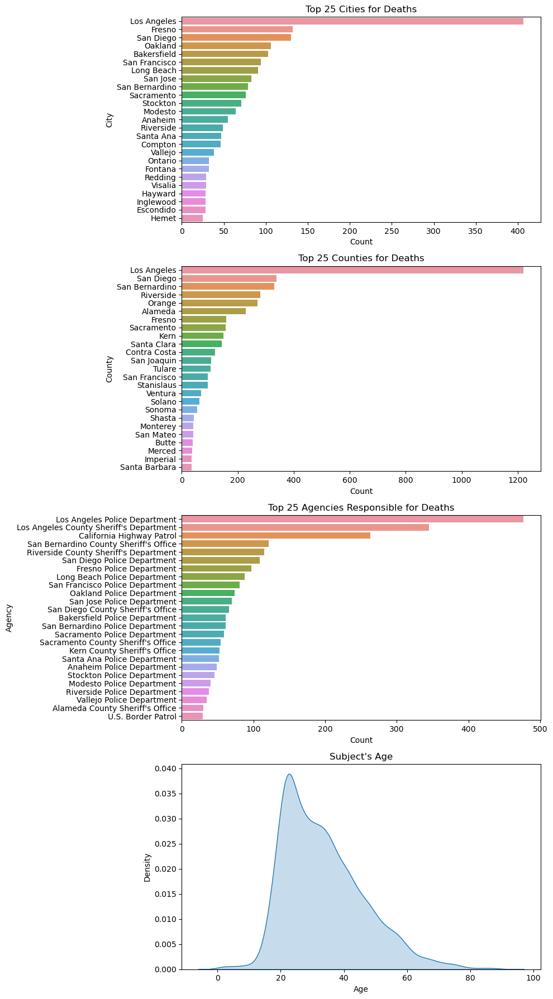

In [27]:
# create figure with subplots
fig, axes = plt.subplots(4, 1, figsize=(10, 18))

# first subplot - top 25 cities for deaths 
sns.countplot(data=ca_df, y='Location_of_death_(city)', 
              order=ca_df['Location_of_death_(city)'].value_counts().index[:25], ax=axes[0])
axes[0].set_xlabel('Count')
axes[0].set_ylabel('City')
axes[0].set_title('Top 25 Cities for Deaths')


# second subplot - top 25 counties for deaths 
sns.countplot(data=ca_df, y='Location_of_death_(county)', 
              order=ca_df['Location_of_death_(county)'].value_counts().index[:25], ax=axes[1])
axes[1].set_xlabel('Count')
axes[1].set_ylabel('County')
axes[1].set_title('Top 25 Counties for Deaths')

# third subplot - top 25 agencies responsible for deaths 
sns.countplot(data=ca_df, y='Agency_responsible_for_death', 
              order=ca_df['Agency_responsible_for_death'].value_counts().index[:25], ax=axes[2])
axes[2].set_xlabel('Count')
axes[2].set_ylabel('Agency')
axes[2].set_title('Top 25 Agencies Responsible for Deaths')


# fourth subplot - subjects age (KDE density plot)
sns.kdeplot(data=ca_df, x='Subjects_age', fill=True, ax=axes[3])
axes[3].set_xlabel('Age')
axes[3].set_ylabel('Density')
axes[3].set_title('Subject\'s Age')


# adjust subplot spacing and display plots 
plt.tight_layout()
plt.show()

The bar plots highlight a clear regional concentration of police fatalities in Los Angeles County, with the Los Angeles Police Department being prominently involved. They also point out that some agencies, such as the US Border Patrol and the Alameda County Sheriff's Office, are associated with fewer fatalities, suggesting variations in incident rates across different law enforcement agencies.

#### Line Plot (Trend of Deaths)

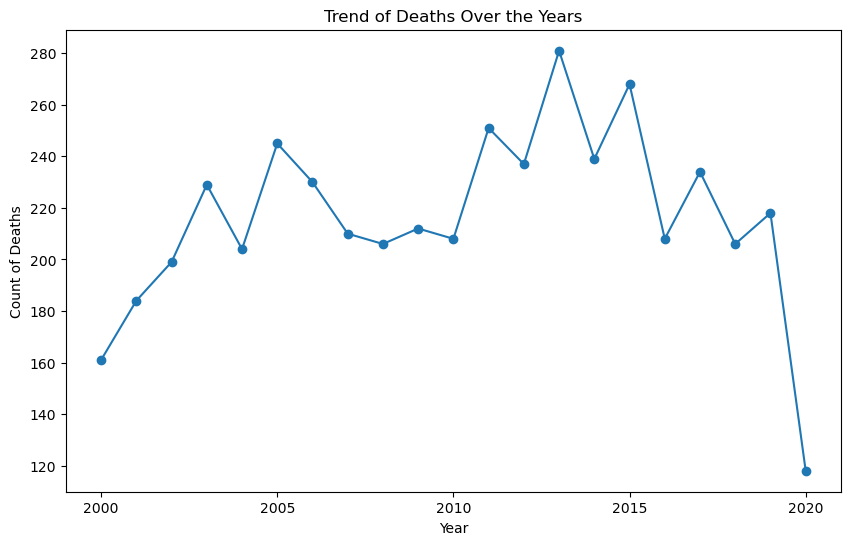

In [28]:
# per boxplot, the years will be filtered to 2000-2020 (outliers removed from 'Injury_Year')
ca_df = ca_df[(ca_df['Injury_Year'] >= 2000) & (ca_df['Injury_Year'] <= 2020)]

# count the number of deaths for each year and sort the results
yearly_deaths = ca_df['Injury_Year'].value_counts().sort_index()

# create a line plot for the trend of deaths over the years 
plt.figure(figsize=(10, 6))
plt.plot(yearly_deaths.index, yearly_deaths.values, marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Count of Deaths')
plt.title('Trend of Deaths Over the Years')

# set x-axis ticks to display every 5 years from 2000 to 2020
plt.xticks(range(2000, 2021, 5))


plt.grid(False) # turn off grid for cleaner plot 
plt.show()

### Removing Outliers 

In [29]:
# removing outliers from 'longitude' and 'latitude' 

# calculate the interquartile range (IQR) for latitude and longitude to identify outliers 
Q1_latitude = ca_df['Latitude'].quantile(0.25)
Q3_latitude = ca_df['Latitude'].quantile(0.75)
IQR_latitude = Q3_latitude - Q1_latitude

Q1_longitude = ca_df['Longitude'].quantile(0.25)
Q3_longitude = ca_df['Longitude'].quantile(0.75)
IQR_longitude = Q3_longitude - Q1_longitude

# define the lower and upper bounds using IQR
latitude_lower_bound = Q1_latitude - 1.5 * IQR_latitude
latitude_upper_bound = Q3_latitude + 1.5 * IQR_latitude

longitude_lower_bound = Q1_longitude - 1.5 * IQR_longitude
longitude_upper_bound = Q3_longitude + 1.5 * IQR_longitude

# filter df to exclude data points that fall outside the defined bounds
filtered_df = ca_df[
    (ca_df['Latitude'] >= latitude_lower_bound) &
    (ca_df['Latitude'] <= latitude_upper_bound) &
    (ca_df['Longitude'] >= longitude_lower_bound) &
    (ca_df['Longitude'] <= longitude_upper_bound)
]

In [30]:
filtered_df

,Unique_ID,Subjects_age,Subjects_gender,Subjects_race,Location_of_injury_(address),Location_of_death_(city),Location_of_death_(county),Latitude,Longitude,Agency_responsible_for_death,Cause_of_death,A_brief_description_of_the_circumstances_surrounding_the_death,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Intentional_Use_of_Force_(Developing),"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Injury_Month,Injury_Year
0,25746,17.0,Male,European-American/White,27898-27804 US-101,Willits,Mendocino,39.470883,-123.361751,Mendocino County Sheriff's Office,Vehicle,Samuel Knapp was allegedly driving a stolen ve...,Unreported,Vehicle/Pursuit,No,1,2000
1,1,24.0,Female,African-American/Black,5700 block Mack Road,Sacramento,Sacramento,38.473949,-121.433776,Sacramento Police Department,Vehicle,LaTanya Janelle McCoy's car was struck from be...,Unknown,Vehicle/Pursuit,No,1,2000
2,8,31.0,Male,Race unspecified,3400 block Gray Street,Muscoy,San Bernardino,34.157941,-117.361652,"San Bernardino Police Department, San Bernardi...",Gunshot,SWAT officers shot and killed Adrian Dolby sho...,Unreported,"Intentional Use of Force, Deadly",Unknown,1,2000
3,10,28.0,Male,Race unspecified,9600 block Cheddar Street,Downey,Los Angeles,33.915678,-118.125081,Downey Police Department,Beaten/Bludgeoned with instrument,Joseph Gumpert stopped breathing after a scuff...,Unreported,Yes,Unknown,1,2000
4,13,24.0,Male,Race unspecified,23600 block Suncrest Avenue,Moreno Valley,Riverside,33.925080,-117.249796,Riverside County Sheriff's Department,Gunshot,Deputies shot and killed Sonny Daniel Diaz whe...,Unreported,"Intentional Use of Force, Deadly",Unknown,1,2000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4543,28294,22.0,Male,Race unspecified,41945 Boardwalk,Palm Desert,Riverside,33.744249,-116.355569,Riverside County Sheriff's Department,Gunshot,Reports of a robbery at C.V. Guns & Tackle cam...,Pending investigation,"Intentional Use of Force, Deadly",No,6,2020
4544,28301,22.0,Female,Asian/Pacific Islander,22000 block Loumont Drive,Lake Forest,Orange,33.630776,-117.699253,Orange County Sheriff's Office,Gunshot,"About 1 a.m., deputies responded to a burglary...",Pending investigation,"Intentional Use of Force, Deadly",Unknown,6,2020
4545,28309,31.0,Male,African-American/Black,"CA-210, west of I-215",San Bernardino,Los Angeles,34.139447,-117.325317,San Bernardino County Sheriff's Office,Gunshot,"Around 9:30 a.m., deputies responded to a susp...",Pending investigation,"Intentional Use of Force, Deadly",No,6,2020
4546,28310,65.0,Female,Hispanic/Latino,1200 block East Avenue S,Palmdale,Los Angeles,34.557522,-118.106008,Los Angeles County Sheriff's Department,Vehicle,Border Patrol agents briefly chased the car be...,Pending investigation,Pursuit,No,6,2020


#### Additional Visualizations (stacked bar plots)

In [31]:
# create a copy of the df specifically for stacked bar plots 
graphs_df = ca_df.copy()

In [32]:
# Combine 'Intentional Use of Force', 'Intenional Use of Force' (spelling error), and 'Yes' into 'Intentional Use of Force, Deadly'
graphs_df['Intentional_Use_of_Force_(Developing)'] = graphs_df['Intentional_Use_of_Force_(Developing)'].replace(
    ['Intentional Use of Force, Deadly', 'Intenional Use of Force, Deadly', 'Yes'],
    'Intentional Use of Force, Deadly'
)

# Combine 'No', 'Suicide', 'Pursuit', and 'Vehicle/Pursuit' into 'Unintentional Use of Force, Deadly'
graphs_df['Intentional_Use_of_Force_(Developing)'] = graphs_df['Intentional_Use_of_Force_(Developing)'].replace(
    ['No', 'Suicide', 'Vehicle/Pursuit', 'Pursuit'],
    'Unintentional Use of Force, Deadly'
)

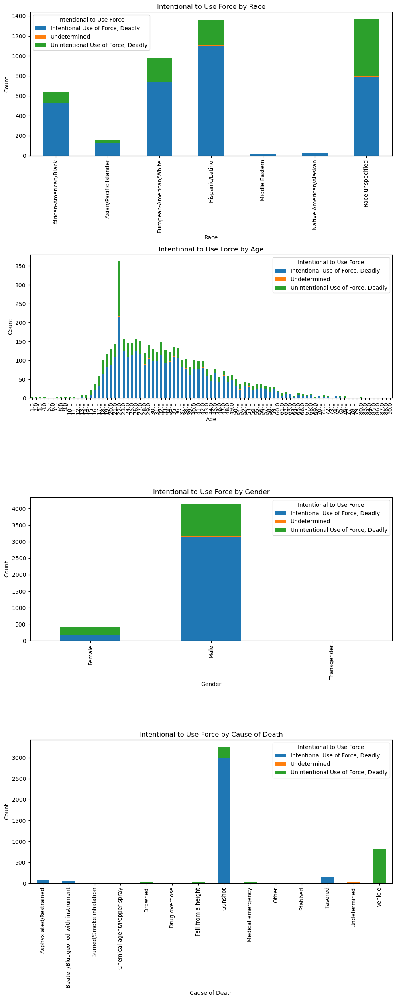

In [33]:
# create a figure with subplots for stacked bar plots (grouped data)
fig, axes = plt.subplots(4, 1, figsize=(10, 25))

# first subplot - 'Race' and 'Intention_to_Use_Force' - count the occurrences
grouped_race = graphs_df.groupby(['Subjects_race', 
                                  'Intentional_Use_of_Force_(Developing)']).size().unstack(fill_value=0)

# create bar chart for 'Race' w/ overlay 'Intention_to_Use_Force'
grouped_race.plot(kind='bar', stacked=True, ax=axes[0])
axes[0].set_xlabel('Race')
axes[0].set_ylabel('Count')
axes[0].set_title('Intentional to Use Force by Race')
axes[0].legend(title='Intentional to Use Force', loc='upper left')

# second subplot - 'Age' and 'Intention_to_Use_Force' - count the occurrences
grouped_age = graphs_df.groupby(['Subjects_age', 
                                 'Intentional_Use_of_Force_(Developing)']).size().unstack(fill_value=0)

# create bar chart for 'Age'  w/ overlay 'Intention_to_Use_Force'
grouped_age.plot(kind='bar', stacked=True, ax=axes[1])
axes[1].set_xlabel('Age')
axes[1].set_ylabel('Count')
axes[1].set_title('Intentional to Use Force by Age')
axes[1].legend(title='Intentional to Use Force', loc='upper right')

# third subplot - 'Gender' and 'Intention_to_Use_Force' - count the occurrences
grouped_gender = graphs_df.groupby(['Subjects_gender', 
                                    'Intentional_Use_of_Force_(Developing)']).size().unstack(fill_value=0)

# create bar chart for 'Gender'  w/ overlay 'Intention_to_Use_Force'
grouped_gender.plot(kind='bar', stacked=True, ax=axes[2])
axes[2].set_xlabel('Gender')
axes[2].set_ylabel('Count')
axes[2].set_title('Intentional to Use Force by Gender')
axes[2].legend(title='Intentional to Use Force', loc='upper right')

# fourth subplot - 'Cause of Death' and 'Intention_to_Use_Force' - count the occurrences
grouped_cause = graphs_df.groupby(['Cause_of_death',
                                   'Intentional_Use_of_Force_(Developing)']).size().unstack(fill_value=0)

# create a bar chart for 'Cause of Death'  w/ overlay 'Intention_to_Use_Force'
grouped_cause.plot(kind='bar', stacked=True, ax=axes[3])
axes[3].set_xlabel('Cause of Death')
axes[3].set_ylabel('Count')
axes[3].set_title('Intentional to Use Force by Cause of Death')
axes[3].legend(title='Intentional to Use Force', loc='upper right')

# adjust subplot spacing and print displays
plt.tight_layout()
plt.show()

From the visualizations, we can conclude that a significant portion of incidents involve individuals of unspecified race, where approximately half are intentional and the other half are unintentional. The second most prevalent racial group comprises of Hispanic/Latinos, with roughly two-thirds of incidents being intentional and one-third unintentional. On the other hand, Middle Eastern and Native American/Alaskan individuals seem to be involved in fewer incidents.

It is noteworthy that a majority of police fatalities are among 22-year-olds, with a considerable concentration in this age group. Age groups between 18 and 45 also exhibit a relatively uniform distribution. Furthermore, there is a substantially higher number of police fatalities among males compared to females, with women comprising 500 cases and men 4,000 cases.

Regarding the causes of police fatalities, a majority of intentional incidents result from gunshots, totaling approximately 3,000 cases. The second leading cause of death is related to vehicles, but these incidents appear to be mostly unintentional, totaling around 1,000 cases.

### Contigency Tables/Chi-Square


We considered 'Cause_of_death' and 'Intentional_Use_of_Force_(Developing)' as potential target variables. The construction and analysis of the two contingency tables aided us in making the decision on which variable to choose as our target.

In [34]:
# define target column to be analyzed for assocation 
target_column = 'Cause_of_death'

# create an empty array to store the results of chi-square test
chi2_results = []

# iterate through all columns (excluding  the target column)
for column in ca_df.columns:
    if column != target_column:
        # create contingency table for independent and  target variable
        cross_tab = pd.crosstab(index=ca_df[column], columns=ca_df[target_column])
        # perform chi-square
        chi2, p, dof, expected = chi2_contingency(cross_tab)
        # append results in array 
        chi2_results.append({
            'Variable': column,
            'Chi-Square Value': chi2,
            'P-Value': p,
            'Degrees of Freedom': dof
        })

# display results in a df 
chi2_df = pd.DataFrame(chi2_results)
chi2_df

,Variable,Chi-Square Value,P-Value,Degrees of Freedom
0,Unique_ID,59124.000000,4.841482e-01,59111
1,Subjects_age,1710.108426,1.275170e-27,1118
2,Subjects_gender,499.696272,4.030832e-89,26
3,Subjects_race,191.762870,1.449316e-11,78
4,Location_of_injury_(address),55884.447874,4.379805e-02,55315
5,Location_of_death_(city),10834.579335,1.137971e-32,9139
6,Location_of_death_(county),1283.730930,1.245392e-36,702
7,Latitude,57265.138598,4.869947e-08,55471
8,Longitude,57265.138598,3.929518e-08,55458
9,Agency_responsible_for_death,9231.163126,2.482851e-39,7514


In [35]:
# define target column to be analyzed for assocation 
target_column = 'Intentional_Use_of_Force_(Developing)'

# create an empty array to store the results of chi-square test
chi2_results = []

# iterate through all columns (excluding  the target column)
for column in ca_df.columns:
    if column != target_column:
        # create contingency table for independent and  target variable
        cross_tab = pd.crosstab(index=ca_df[column], columns=ca_df[target_column])
         # perform chi-square
        chi2, p, dof, expected = chi2_contingency(cross_tab)
         # append results in array 
        chi2_results.append({
            'Variable': column,
            'Chi-Square Value': chi2,
            'P-Value': p,
            'Degrees of Freedom': dof
        })

# display resultsin a df 
chi2_df = pd.DataFrame(chi2_results)
chi2_df

,Variable,Chi-Square Value,P-Value,Degrees of Freedom
0,Unique_ID,31836.000000,4.878803e-01,31829
1,Subjects_age,973.562079,5.252351e-20,602
2,Subjects_gender,434.081105,8.213261e-84,14
3,Subjects_race,342.647123,8.687141e-49,42
4,Location_of_injury_(address),30890.816069,3.757128e-06,29785
5,Location_of_death_(city),7257.715397,1.040673e-94,4921
6,Location_of_death_(county),615.277636,1.318081e-13,378
7,Latitude,31376.689052,6.376562e-10,29869
8,Longitude,31376.689052,5.340616e-10,29862
9,Agency_responsible_for_death,7248.872701,7.372474e-186,4046


'Intentional_Use_of_Force_(Developing)' was defined as the target variable, supported by the chi-squared test results. Its significantly low p-value of 0 and high chi-squared value demonstrate a strong association with the other variables, making it a clear and appropriate selection as the target variable for analysis. In contrast, 'Cause_of_death' does not exhibit such a strong association with the other variables, reinforcing the suitability of 'Intentional_Use_of_Force_(Developing)' as the preferred target variable.

In [36]:
# create contigency table for 'Intentional_Use_of_Force_(Developing)' and 'Cause_of_death'
contingency_force = pd.crosstab(ca_df['Intentional_Use_of_Force_(Developing)'], ca_df ['Cause_of_death'])

contingency_force

Cause_of_death,Asphyxiated/Restrained,Beaten/Bludgeoned with instrument,Burned/Smoke inhalation,Chemical agent/Pepper spray,Drowned,Drug overdose,Fell from a height,Gunshot,Medical emergency,Other,Stabbed,Tasered,Undetermined,Vehicle
Intentional_Use_of_Force_(Developing),,,,,,,,,,,,,,
"Intenional Use of Force, Deadly",0,0,0,0,0,0,0,21,0,0,0,0,0,0
"Intentional Use of Force, Deadly",0,0,0,0,0,0,0,2977,0,1,1,0,0,0
No,0,1,0,0,35,12,13,0,29,0,2,0,3,0
Pursuit,0,0,0,0,0,0,0,0,0,0,0,0,0,4
Suicide,1,0,1,0,1,1,7,269,0,1,2,2,0,1
Undetermined,0,0,0,0,0,1,0,0,1,0,0,0,23,0
Vehicle/Pursuit,0,0,0,0,0,0,0,0,0,0,0,0,0,820
Yes,72,49,4,7,0,0,1,0,12,4,0,155,14,0


In [37]:
# create contigency table for 'Intentional_Use_of_Force_(Developing)' and 'Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS'
contingency_disposition = pd.crosstab(ca_df['Intentional_Use_of_Force_(Developing)'], ca_df['Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS'])

contingency_disposition

"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Accidental,Administrative discipline,Administrative discipline/Civil suit/Family awarded money,Civil suit/Family awarded money,Civil suit/Pending,Civil suit/Results unreported,Cleared,Criminal,Criminal/Off-duty,Drug overdose,...,Pending investigation,Possible suicide,Possibly suicide,Ruled accidental,Ruled suicide,Ruled suicide by police,Suicide,Unknown,Unreported,Use of force justified
Intentional_Use_of_Force_(Developing),,,,,,,,,,,,,,,,,,,,,
"Intenional Use of Force, Deadly",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,2,19,0
"Intentional Use of Force, Deadly",2,2,2,6,1,0,53,19,1,0,...,740,1,1,0,0,1,0,162,1252,3
No,9,1,0,0,0,0,7,1,0,0,...,12,0,0,1,0,0,0,6,53,2
Pursuit,0,0,0,0,0,0,0,0,0,0,...,2,0,0,0,0,0,0,0,2,0
Suicide,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,67,0,219,0,0,0
Undetermined,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,1,23,0
Vehicle/Pursuit,8,1,0,1,0,1,31,62,0,0,...,88,0,0,1,0,0,0,53,565,0
Yes,12,0,0,1,1,1,57,2,0,1,...,61,0,0,1,0,0,0,13,134,0


The contingency tables reveal that 'Intentional_Use_of_Force_(Developing)' is closely associated with certain causes of death and dispositions. Notably, 'Intentional Use of Force, Deadly' frequently corresponds to 'Gunshot' as the primary cause of death, while categories like 'Vehicle' are more prevalent but appear largely unintentional. 

In terms of dispositions, 'Cleared' and 'Criminal' are more common in 'Intentional Use of Force, Deadly.' These findings underscore that 'Intentional_Use_of_Force_(Developing)' is a meaningful choice for the target variable, given the distinct patterns observed in the data.

### ANOVA (Cause of Death and Numerical Values)

In [38]:
# perform ANOVA (Analysis of Variance) between numerical variables and 'Intentional_Use_of_Force_(Developing)'

# iterate through the selected numerical predictors
for predictor in ['Subjects_age', 'Latitude', 'Longitude', 'Injury_Year']:
    # create list of grouped data for each category of target variable
    grouped_data = [ca_df[predictor][ca_df['Intentional_Use_of_Force_(Developing)'] == category] for category in ca_df['Intentional_Use_of_Force_(Developing)'].unique()]
    
    # calculate the F-statistic and p-value using one-way ANOVA
    f_statistic, p_value = stats.f_oneway(*grouped_data)
    print(f'{predictor} vs. Intentional/Unintentional Use of Force:')
    print(f'F-statistic: {f_statistic}')
    print(f'P-value: {p_value}\n')

Subjects_age vs. Intentional/Unintentional Use of Force:
F-statistic: 11.17285183891685
P-value: 4.273220999321981e-14

Latitude vs. Intentional/Unintentional Use of Force:
F-statistic: 5.504725747324198
P-value: 2.5525418405275443e-06

Longitude vs. Intentional/Unintentional Use of Force:
F-statistic: 3.8648134707511526
P-value: 0.0003349067203309522

Injury_Year vs. Intentional/Unintentional Use of Force:
F-statistic: 7.143344421767588
P-value: 1.611857615015973e-08



ANOVA displays a strong associations between numerical variables and the the target variable 'Intentional_Use_of_Force_(Developing)'. 'Subjects_age', 'Latitude', 'Longitude',  and 'Injury_Year' were all significantly related to the intention behind the use of force. These findings highlight the key factors influencing the classification of force and provide insights to the dynamics within the df.

### Text Analysis (brief description column)

In [39]:
# extract the column containing descriptions of circumstances surrounding the deaths
#('A_brief_description_of_the_circumstances_surrounding_the_death') for text analysis 
corpus = ca_df['A_brief_description_of_the_circumstances_surrounding_the_death']

# create variable 'corpus' to hold  text data for analysis (analyzing the descriptions of circumstances)

# display last few entries of the 'corpus'to understand what the text data looks like 
corpus.tail()

4543    Reports of a robbery at C.V. Guns & Tackle cam...
4544    About 1 a.m., deputies responded to a burglary...
4545    Around 9:30 a.m., deputies responded to a susp...
4546    Border Patrol agents briefly chased the car be...
4547    Louis Lane showed up at theWalmart distributio...
Name: A_brief_description_of_the_circumstances_surrounding_the_death, dtype: object

In [40]:
corpus.describe() # column has 4330 unique values with a total count of 4540 values 

count                                                  4548
unique                                                 4338
top       A car stolen at knifepoint and doing 80 MPH on...
freq                                                      8
Name: A_brief_description_of_the_circumstances_surrounding_the_death, dtype: object

In [41]:
# create tfidfVectorizer
vectorizer = TfidfVectorizer()

# apply vectorizer to corpus to convert text data into a numeric format - results are stored in'spmat'
spmat = vectorizer.fit_transform(corpus)

# create new df 'X'
X = pd.DataFrame.sparse.from_spmatrix(spmat)

In [42]:
# create a label variable 
labels = ca_df['Intentional_Use_of_Force_(Developing)']

# subset labels that have text data present
text_subset = labels.loc[corpus.index]

text_subset

0                        Vehicle/Pursuit
1                        Vehicle/Pursuit
2       Intentional Use of Force, Deadly
3                                    Yes
4       Intentional Use of Force, Deadly
                      ...               
4543    Intentional Use of Force, Deadly
4544    Intentional Use of Force, Deadly
4545    Intentional Use of Force, Deadly
4546                             Pursuit
4547    Intentional Use of Force, Deadly
Name: Intentional_Use_of_Force_(Developing), Length: 4548, dtype: object

In [43]:
# split the datainto train and testing 50/50 split
X_train, X_test, y_train, y_test = train_test_split(X, text_subset,
                                                    test_size=0.50)

In [44]:
# perform feature selection using SelectKBest w/f_classif scoring 
# select the top 10 features
X_new = SelectKBest(score_func=f_classif, k=25)

# fit selector on training data
X_new.fit(X_train, y_train)

# transform training and test data to keep selected features
X_train_selected = X_new.transform(X_train)
X_test_selected = X_new.transform(X_test)

In [45]:
# print top 25 features based on feature selection
print('Top 25 features %s' % X_train.columns[X_new.get_support()].tolist())

Top 25 features [226, 372, 456, 562, 848, 1412, 1632, 2273, 2408, 2817, 3038, 3093, 3663, 4059, 4430, 5418, 6075, 6573, 6589, 7378, 7635, 8365, 8531, 9077, 9683]


In [46]:
# retrieve feature names from vectorizer
feature_names = vectorizer.get_feature_names_out()

# get indices of the top 10 selected features
selected_indices = X_new.get_support(indices=True)

# top 25 selected words based on feature selection
print('Top 25 selected words:', [feature_names[i] for i in selected_indices])

Top 25 selected words: ['90', 'ages', 'alien', 'angelica', 'avelino', 'briefly', 'canal', 'contreras', 'crashed', 'died', 'drowned', 'duty', 'fleeing', 'govea', 'himself', 'leobardo', 'milagros', 'occurring', 'ofelia', 'quit', 'reportedly', 'shot', 'smuggling', 'tasered', 'velasco']


In [47]:
# drop 'A_brief_description_of_the_circumstances_surrounding_the_death'
ca_df.drop(columns=['A_brief_description_of_the_circumstances_surrounding_the_death'], inplace=True)

The 'A_brief_description_of_the_circumstances_surrounding_the_death' column contains words that are irrelevant to the analysis of police fatalities. By removing this column, we streamline our dataset, enhance data quality, and focus our analysis on more pertinent factors, such as location, demographics, and agencies involved, ensuring a more meaningful and accurate examination of the problem.

### Variable Importance

In [48]:
# define the target variable - select numeric columns 
X_numeric = ca_df.select_dtypes(include=['float64', 'int64'])

# create a df for VIF values
vif = pd.DataFrame()
vif["Variable"] = X_numeric.columns

# calculate/store VIF values for each numeric variable
vif["VIF"] = [variance_inflation_factor(X_numeric.values, i) for i in range(X_numeric.shape[1])]
print(vif)

       Variable          VIF
0  Subjects_age     7.910802
1      Latitude   619.574063
2     Longitude  5247.403991
3  Injury_Month     4.490479
4   Injury_Year  3247.224988


Based on the variable importance analysis, it is advisable to remove the columns 'Latitude,' 'Longitude,' and 'Injury_Year.' High multicollinearity, as observed in these columns, can diminish interpretability and undermine the significance of variables genuinely associated with the target variable.

In [49]:
# drop redudant columns that will not be used for modeling due to high VIF and low p-values 
ca_df.drop(columns=['Latitude', 'Longitude','Location_of_injury_(address)',
                    'Injury_Year'],inplace=True)

## Data Pre-Processing

In [50]:
# print values within the column 'Intentional_Use_of_Force_(Developing)'
ca_df['Intentional_Use_of_Force_(Developing)'].unique()

array(['Vehicle/Pursuit', 'Intentional Use of Force, Deadly', 'Yes',
       'Suicide', 'No', 'Undetermined', 'Intenional Use of Force, Deadly',
       'Pursuit'], dtype=object)

In [51]:
# map values into two categories intentional use of force and unintentional

# define the mapping of values to categories
mapping = {
    'Vehicle/Pursuit': 'Unintentional Use of Force, Deadly',
    'Intentional Use of Force, Deadly': 'Intentional Use of Force, Deadly',
    'Yes': 'Intentional Use of Force, Deadly',
    'Suicide': 'Unintentional Use of Force, Deadly',
    'No': 'Unintentional Use of Force, Deadly',
    'Undetermined': 'Unintentional Use of Force, Deadly',
    'Intenional Use of Force, Deadly': 'Intentional Use of Force, Deadly', 
    'Pursuit': 'Unintentional Use of Force, Deadly', 
}

# replace values based on the mapping
force_df = ca_df['Intentional_Use_of_Force_(Developing)'].map(mapping)

# verify the result
force_df.unique()

array(['Unintentional Use of Force, Deadly',
       'Intentional Use of Force, Deadly'], dtype=object)

In [52]:
# value count of force_df (y variable)
force_df.value_counts() #Intentional and unintentional appear to be unbalanced 

Intentional Use of Force, Deadly      3318
Unintentional Use of Force, Deadly    1230
Name: Intentional_Use_of_Force_(Developing), dtype: int64

In [53]:
filtered_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4540 entries, 0 to 4547
Data columns (total 17 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   Unique_ID                                                       4540 non-null   object 
 1   Subjects_age                                                    4540 non-null   float64
 2   Subjects_gender                                                 4540 non-null   object 
 3   Subjects_race                                                   4540 non-null   object 
 4   Location_of_injury_(address)                                    4540 non-null   object 
 5   Location_of_death_(city)                                        4540 non-null   object 
 6   Location_of_death_(county)                                      4540 non-null   object 
 7   Latitude                                           

### Encoding Data

In [54]:
# create a copy of ca_df 
filtered_encoded_df = ca_df.copy()

# identify categorical columns to be encoded
categorical_columns = ['Subjects_gender', 'Subjects_race', 'Location_of_death_(city)', 
                       'Location_of_death_(county)', 'Agency_responsible_for_death',
                       'Cause_of_death', 'Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS',  
                       'Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS'
]

# create df for categorical features
cat_df = filtered_encoded_df[categorical_columns]


# initialize one-hot encoding with handle_unknown set to 'ignore'
encoder = OneHotEncoder(handle_unknown = 'ignore', sparse=False)
encoded_cat = encoder.fit_transform(cat_df)

# get the feature names after encoding
feature_names = encoder.get_feature_names_out(input_features=categorical_columns)

# fill missing values in the encoded df with 0
encoded_df = pd.DataFrame(encoded_cat, columns=feature_names)
encoded_df.fillna(0, inplace=True) 

# drop the categorical columns from ca_df
catcol_df = ca_df.drop(columns=categorical_columns)

# concatenate the original df and df with encoded features
encoded_df = pd.concat([catcol_df, encoded_df], axis=1)

In [55]:
# check for null values 
encoded_df.isna().sum() #df appears to have 67 null values after encoding 

Unique_ID                                                                         0
Subjects_age                                                                      0
Intentional_Use_of_Force_(Developing)                                             0
Injury_Month                                                                      0
Subjects_gender_Female                                                            0
                                                                                 ..
Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Use of force justified     0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Drug or alcohol use    0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_No                     0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unknown                0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Yes                    0
Length: 1404, dtype: int64

In [56]:
encoded_df.shape # encoded df has 4413 rows and 1390 columns 

(4548, 1404)

### Principal Componet Analysis (PCA) 

In [57]:
# create a copy of encoded_df before applying PCA 
pca_df = encoded_df.copy()

In [58]:
# drop preidctor varaible ('Intentional_Use_of_Force_(Developing)')
pca_df = pca_df.drop('Intentional_Use_of_Force_(Developing)', axis=1)

In [59]:
# standardize the data
scaler = StandardScaler()
# fit and transform data using scaler 
encoded_standardized = scaler.fit_transform(pca_df)

In [60]:
# apply PCA
pca = PCA()
pca.fit(encoded_standardized)

# calculate the cumulative explained variance ratio
explained_variance_ratio_cumulative = np.cumsum(pca.explained_variance_ratio_)

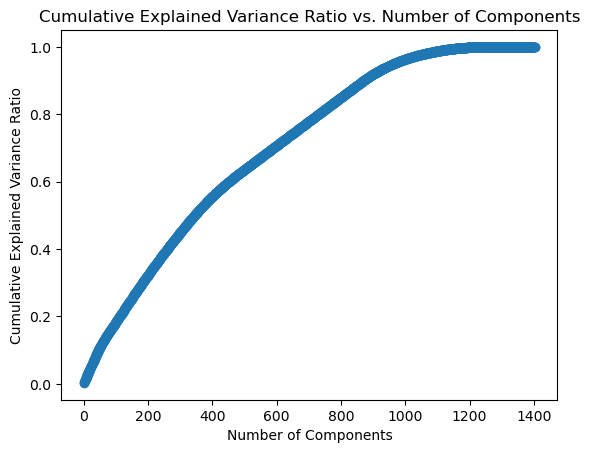

In [61]:
# plot cumulative explained variance ratio
plt.plot(range(1, len(explained_variance_ratio_cumulative) + 1), explained_variance_ratio_cumulative, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.title('Cumulative Explained Variance Ratio vs. Number of Components')
plt.show()

In [62]:
# find the number of components that fall within 80% to 90% cumulative explained variance
target_variance_range = (0.80, 0.90)

# use NumPy to find the index of the first component within the specified variance range
target_components = np.where((explained_variance_ratio_cumulative >= target_variance_range[0]) &
                             (explained_variance_ratio_cumulative <= target_variance_range[1]))[0][0] + 1

print("Ideal number of components within 80% to 90% variance range:", target_components)

Ideal number of components within 80% to 90% variance range: 730


Through principal component analysis (PCA), it has been established that the optimal number of components to retain falls within the variance range of 80% to 90%, and this ideal number is found to be 716. Out of the 1404 columns in the dataframe, only 716 will be used to build the model.

### Data Splitting

In [63]:
# create a copy of encoded_standardized df
ca_df = encoded_standardized.copy()

In [64]:
# split the dataset to predict whether death was intentional 
X = ca_df
y = force_df #Intentional_Use_of_Force_(Developing)is stored in its own df 

# split data into 60/40 split creating a temp set to store the validation and test
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)

# split reaming data from temp ste into test and validation 50/50 split 
X_valid, X_test, y_valid, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# scale the train, test, and validation set
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
X_valid_scaled = scaler.transform(X_valid)

# Apply PCA with 730 components
n_components = 730
pca = PCA(n_components=n_components)
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)
X_valid_pca = pca.transform(X_valid_scaled)

# create a SMOTE object
smote = SMOTE(random_state=42)

# apply SMOTE to your training data to balance y
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_pca, y_train)


# print the dimensions of X_train_pca and X_test_pca
print("Dimensions of X_train_pca:", X_train_resampled.shape)
print("Dimensions of X_test_pca:", X_test_pca.shape)
print("Dimensions of X_valid_pca:", X_valid_pca.shape)

Dimensions of X_train_pca: (4022, 730)
Dimensions of X_test_pca: (910, 730)
Dimensions of X_valid_pca: (910, 730)


During PCA application, the columns lose their original labels. However, the process involves the selection of vital components and the subsequent generation of new DataFrames containing the transformed data, ensuring that the initial feature names are retained as column identifiers for reference and analysis.

In [65]:
# retrive original feature names from df and store them  in the variable
original_feature_names = pca_df.columns

# create df for PCA-transformed data with original feature names from pca_df
selected_feature_indices = pca.components_.argsort()[:, ::-1][:, :n_components]
selected_feature_names = original_feature_names[selected_feature_indices[0]]
X_train_resampled = pd.DataFrame(X_train_resampled, columns=selected_feature_names)
X_test_pca = pd.DataFrame(X_test_pca, columns=selected_feature_names)

## Models

### Naive Bayes

In [67]:
# Build and fit the Naive Bayes classifier 
nb_clf = GaussianNB()
nb_clf.fit(X_train_resampled, y_train_resampled)

# Predict on the train set
nb_pred = nb_clf.predict(X_train_resampled)
nb_prob = nb_clf.predict_proba(X_train_resampled)[:, 1]

# Calculate the confusion matrix
cm = confusion_matrix(y_train_resampled, nb_pred)

# Calculate specificity, sensitivity (recall), and F1 score
tn, fp, fn, tp = cm.ravel()

nb_specificity = tn / (tn + fp)
nb_sensitivity = tp / (tp + fn)
nb_f1 = f1_score(y_train_resampled, nb_pred, pos_label='Intentional Use of Force, Deadly')
nb_acc = accuracy_score(y_train_resampled, nb_pred)
nb_roc_auc = roc_auc_score(y_train_resampled, nb_prob)


print("Confusion Matrix:")
print(cm)
print("Accuracy:", nb_acc)
print("Specificity:", nb_specificity)
print("Sensitivity (Recall):", nb_sensitivity)
print("F1 Score:", nb_f1)
print("ROC-AUC Score:", nb_roc_auc)

Confusion Matrix:
[[ 714 1297]
 [ 331 1680]]
Accuracy: 0.5952262555942317
Specificity: 0.3550472401790154
Sensitivity (Recall): 0.8354052710094481
F1 Score: 0.4672774869109948
ROC-AUC Score: 0.6027353039140027


In [68]:
# define the hyperparameter grid
param_grid = {
    'var_smoothing': [1e-9, 1e-8, 1e-7],
}

# create new Gradient Boosting classifier
nb_clf = GaussianNB()

# preform grid search with cross validation and fit to data
grid_search = GridSearchCV(nb_clf, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train_scaled, y_train)

# get the best parameters and best estimator
best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_

print("Best Parameters:", best_params)
print("Best Estimator:", best_estimator)

Best Parameters: {'var_smoothing': 1e-09}
Best Estimator: GaussianNB()


In [69]:
# build and fit new Naive Bayes Model w/best estimators 
nb_clf = GaussianNB()

# Fit to data 
nb_clf.fit(X_train_resampled, y_train_resampled)

# Predict on the validation set
nb_pred = nb_clf.predict(X_valid_pca)
nb_prob = nb_clf.predict_proba(X_valid_pca)[:, 1]

# Calculate the confusion matrix
cm = confusion_matrix(y_valid, nb_pred)

# Calculate specificity, sensitivity (recall), and F1 score
tn, fp, fn, tp = cm.ravel()

nb_2_specificity = tn / (tn + fp)
nb_2_sensitivity = tp / (tp + fn)
nb_2_f1 = f1_score(y_valid, nb_pred, pos_label='Intentional Use of Force, Deadly')
nb_2_acc = accuracy_score(y_valid, nb_pred)
nb_roc2_auc = roc_auc_score(y_valid, nb_prob)


print("Confusion Matrix:")
print(cm)
print("Accuracy:", nb_2_acc)
print("Specificity:", nb_2_specificity)
print("Sensitivity (Recall):", nb_2_sensitivity)
print("F1 Score:", nb_2_f1)
print("ROC-AUC Score:", nb_roc2_auc)

Confusion Matrix:
[[176 481]
 [ 75 178]]
Accuracy: 0.389010989010989
Specificity: 0.2678843226788432
Sensitivity (Recall): 0.7035573122529645
F1 Score: 0.3876651982378855
ROC-AUC Score: 0.47811648347681696


In [71]:
from sklearn.inspection import permutation_importance
# Calculate permutation importance
perm_importance = permutation_importance(nb_clf, X_test_pca, y_test,
                                         n_repeats=30, random_state=42)

# Get the importances and indices of features
importances = perm_importance.importances_mean
feature_indices = np.argsort(importances)[::-1]

# Get the original column names from X_train
original_column_names = X_train_resampled.columns

# Create a DataFrame to store the importance of each feature
importance_df = pd.DataFrame({'Feature': original_column_names[feature_indices],
                              'Importance': importances[feature_indices]})

# Display top 10 feature importance 
top_10_importance_df = importance_df.head(10)
top_10_importance_df

,Feature,Importance
0,Location_of_death_(city)_Lemon Grove,0.003187
1,Location_of_death_(county)_Orange,0.003077
2,Location_of_death_(city)_North Sacramento,0.002015
3,Agency_responsible_for_death_Ceres Police Depa...,0.002015
4,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_...",0.001905
5,Location_of_death_(city)_Baker,0.001868
6,Location_of_death_(city)_Exeter,0.001685
7,Location_of_death_(city)_Crockett,0.001685
8,Agency_responsible_for_death_Richmond Police D...,0.001648
9,Agency_responsible_for_death_San Bernardino Co...,0.001648


### Gradient Boosting

In [72]:
# Build and fit the Gradient Boosting classifier 
gb_clf = GradientBoostingClassifier(random_state=42)
gb_clf.fit(X_train_resampled, y_train_resampled)

# Predict on the train set
gb_pred = gb_clf.predict(X_train_resampled)
gb_prob = gb_clf.predict_proba(X_train_resampled)[:, 1]

# Calculate the confusion matrix
cm = confusion_matrix(y_train_resampled, gb_pred)

# Calculate specificity, sensitivity (recall), and F1 score
tn, fp, fn, tp = cm.ravel()

gb_specificity = tn / (tn + fp)
gb_sensitivity = tp / (tp + fn)
gb_f1 = f1_score(y_train_resampled, gb_pred, pos_label='Intentional Use of Force, Deadly')
gb_acc = accuracy_score(y_train_resampled, gb_pred)
gb_roc_auc = roc_auc_score(y_train_resampled, gb_prob)


print("Confusion Matrix:")
print(cm)
print("Accuracy:", gb_acc)
print("Specificity:", gb_specificity)
print("Sensitivity (Recall):", gb_sensitivity)
print("F1 Score:", gb_f1)
print("ROC-AUC Score:", gb_roc_auc)

Confusion Matrix:
[[1999   12]
 [   1 2010]]
Accuracy: 0.9967677772252611
Specificity: 0.9940328194927897
Sensitivity (Recall): 0.9995027349577325
F1 Score: 0.9967589129892795
ROC-AUC Score: 0.9999525236757258


In [73]:
# define the hyperparameter grid
param_grid = {
    'learning_rate': [0.01, 0.1, 0.2],
    'n_estimators': [50, 100, 200],
    'max_depth': [3, 4, 5],
    'subsample': [0.8, 1.0],
}

# create a new Gradient Boosting classifier
gb_clf = GradientBoostingClassifier(random_state=42)

# preform grid search with cross validation and fit to data
grid_search = GridSearchCV(gb_clf, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train_scaled, y_train)

# get best parameters and best estimator
best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_

print("Best Parameters:", best_params)
print("Best Estimator:", best_estimator)

Best Parameters: {'learning_rate': 0.2, 'max_depth': 4, 'n_estimators': 200, 'subsample': 0.8}
Best Estimator: GradientBoostingClassifier(learning_rate=0.2, max_depth=4, n_estimators=200,
                           random_state=42, subsample=0.8)


In [74]:
# build and fit the Gradient Boosting classifier using best parameters
gb_clf= GradientBoostingClassifier(learning_rate=0.2, 
                                   max_depth=4, 
                                   n_estimators=200,
                                   random_state=42, 
                                   subsample=0.8)
gb_clf.fit(X_train_resampled, y_train_resampled)

# predict on the test set
gb_pred = gb_clf.predict(X_valid_pca)
gb_prob = gb_clf.predict_proba(X_valid_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_valid, gb_pred)

# calculate specificity, sensitivity (recall), and F1 score
tn, fp, fn, tp = cm.ravel()

gb_2_specificity = tn / (tn + fp)
gb_2_sensitivity = tp / (tp + fn)
gb_2_f1 = f1_score(y_valid, gb_pred, pos_label='Intentional Use of Force, Deadly')
gb_2_acc = accuracy_score(y_valid, gb_pred)
gb_roc2_auc = roc_auc_score(y_valid, gb_prob)

print("Confusion Matrix:")
print(cm)
print("Accuracy:", gb_2_acc)
print("Specificity:", gb_2_specificity)
print("Sensitivity (Recall):", gb_2_sensitivity)
print("F1 Score:", gb_2_f1)
print("ROC-AUC Score:", gb_roc2_auc)

Confusion Matrix:
[[642  15]
 [ 30 223]]
Accuracy: 0.9505494505494505
Specificity: 0.9771689497716894
Sensitivity (Recall): 0.8814229249011858
F1 Score: 0.9661399548532732
ROC-AUC Score: 0.9848996215881266


In [75]:
# calculate permutation importance
perm_importance = permutation_importance(gb_clf, X_test_pca, y_test,
                                         n_repeats=30, random_state=42)

# get the importances and indices of features
importances = perm_importance.importances_mean
feature_indices = np.argsort(importances)[::-1]

# get the original column names from X_train
original_column_names = X_train_resampled.columns

# create a DataFrame to store the importance of each feature
importance_df = pd.DataFrame({'Feature': original_column_names[feature_indices],
                              'Importance': importances[feature_indices]})

# display top 10 feature importance 
top_10_importance_df = importance_df.head(10)
top_10_importance_df

,Feature,Importance
0,Cause_of_death_Vehicle,0.056667
1,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_...",0.016044
2,Agency_responsible_for_death_Dinuba Police Dep...,0.005897
3,Agency_responsible_for_death_Oakland Police De...,0.005751
4,Location_of_death_(city)_Winchester,0.004505
5,Agency_responsible_for_death_San Anselmo Polic...,0.004359
6,Agency_responsible_for_death_U.S. Customs and ...,0.004249
7,Agency_responsible_for_death_U.S. National Par...,0.003480
8,Location_of_death_(city)_West Sacramento,0.002821
9,Location_of_death_(city)_Lake Los Angeles,0.002381


### Neural Network

In [76]:
# build and fit the Neural Network classifier 
nn_clf = MLPClassifier(random_state=42)
nn_clf.fit(X_train_resampled, y_train_resampled)

# predict on the train set
nn_pred = nn_clf.predict(X_train_resampled)
nn_prob = nn_clf.predict_proba(X_train_resampled)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_train_resampled, nn_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

nn_specificity = tn / (tn + fp)
nn_sensitivity = tp / (tp + fn)
nn_f1 = f1_score(y_train_resampled, nn_pred, pos_label='Intentional Use of Force, Deadly')
nn_acc = accuracy_score(y_train_resampled, nn_pred)
nn_roc_auc = roc_auc_score(y_train_resampled, nn_prob)

print ("Train Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", nn_acc)
print("Specificity:", nn_specificity)
print("Sensitivity (Recall):", nn_sensitivity)
print("F1 Score:", nn_f1)
print("ROC-AUC Score:", nn_roc_auc)

Train Set Metrics
Confusion Matrix:
[[2011    0]
 [   0 2011]]
Accuracy: 1.0
Specificity: 1.0
Sensitivity (Recall): 1.0
F1 Score: 1.0
ROC-AUC Score: 1.0


In [77]:
# network structure
print('Intercepts')
print(nn_clf.intercepts_)
print('Weights')
print(nn_clf.coefs_)

Intercepts
[array([ 0.15811575,  0.17403579, -0.04308345,  0.07357755,  0.1638323 ,
       -0.09020152,  0.17157109, -0.06288325,  0.11840858, -0.0087573 ,
        0.0685701 , -0.043346  , -0.01144366,  0.17744025, -0.05590764,
       -0.05255905, -0.04292777, -0.02409896,  0.12044622, -0.07880521,
       -0.05328525,  0.16109436, -0.06453927,  0.17330946, -0.07716402,
       -0.01470384,  0.04124989,  0.03854193,  0.26722746, -0.0875213 ,
        0.22003012, -0.09527094,  0.03071902,  0.00239903,  0.04534947,
       -0.00368661,  0.04064204,  0.11842232,  0.08047886, -0.04223249,
       -0.0633361 , -0.05285972,  0.02662517,  0.12951856,  0.0054636 ,
       -0.06518357,  0.05612082,  0.22831098, -0.08858394,  0.19509214,
        0.02874896, -0.04141105,  0.15209548,  0.09700319,  0.08563152,
        0.02535653,  0.00316283,  0.12943966,  0.11017215, -0.07487   ,
        0.14643171,  0.19343045,  0.15309631, -0.02534944,  0.04171261,
        0.19486001, -0.05643022,  0.11111647, -0.035

In [78]:
# define the hyperparameter grid
param_grid = {
    'hidden_layer_sizes': [(100,), (50, 50), (100, 50)],
    'activation': ['relu', 'tanh'],
    'learning_rate_init': [0.001, 0.01],
    'max_iter': [200, 300],
}

# create a new Neural Network classifier 
nn_clf = MLPClassifier(random_state=42)

# preform grid search with cross validation and fit to data
grid_search = GridSearchCV(nn_clf, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train_scaled, y_train)

# get the best parameters and best estimator
best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_

print("Best Parameters:", best_params)
print("Best Estimator:", best_estimator)

Best Parameters: {'activation': 'relu', 'hidden_layer_sizes': (50, 50), 'learning_rate_init': 0.01, 'max_iter': 200}
Best Estimator: MLPClassifier(hidden_layer_sizes=(50, 50), learning_rate_init=0.01,
              random_state=42)


In [79]:
# build and fit new Neural Network classifier w/best parameters 
nn_clf = MLPClassifier(hidden_layer_sizes=(50, 50), 
                        learning_rate_init=0.01,
                        random_state=42)
nn_clf.fit(X_train_resampled, y_train_resampled)

# predict on the test set
nn_pred = nn_clf.predict(X_valid_pca)
nn_prob = nn_clf.predict_proba(X_valid_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_valid, nn_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

nn_2_specificity = tn / (tn + fp)
nn_2_sensitivity = tp / (tp + fn)
nn_2_f1 = f1_score(y_valid, nn_pred, pos_label='Intentional Use of Force, Deadly')
nn_2_acc = accuracy_score(y_valid, nn_pred)
nn_roc2_auc = roc_auc_score(y_valid, nn_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", nn_2_acc)
print("Specificity:", nn_2_specificity)
print("Sensitivity (Recall):", nn_2_sensitivity)
print("F1 Score:", nn_2_f1) 
print("ROC-AUC Score:", nn_roc2_auc)

Test Set Metrics
Confusion Matrix:
[[631  26]
 [ 21 232]]
Accuracy: 0.9483516483516483
Specificity: 0.9604261796042618
Sensitivity (Recall): 0.9169960474308301
F1 Score: 0.9640947288006111
ROC-AUC Score: 0.9743293566998152


In [80]:
# calculate permutation importance
perm_importance = permutation_importance(nn_clf, X_test_pca, y_test,
                                         n_repeats=30, random_state=42)

# get the importances and indices of features
importances = perm_importance.importances_mean
feature_indices = np.argsort(importances)[::-1]

# get the original column names from X_train
original_column_names = X_train_resampled.columns

# create a DataFrame to store the importance of each feature
importance_df = pd.DataFrame({'Feature': original_column_names[feature_indices],
                              'Importance': importances[feature_indices]})

# display top 10 feature importance 
top_10_importance_df = importance_df.head(10)
top_10_importance_df

,Feature,Importance
0,Cause_of_death_Vehicle,0.047692
1,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_...",0.037216
2,Agency_responsible_for_death_Pittsburg Police ...,0.007766
3,Location_of_death_(city)_Dublin,0.007033
4,Location_of_death_(city)_Redlands,0.006813
5,Agency_responsible_for_death_Dinuba Police Dep...,0.005311
6,Agency_responsible_for_death_Oakland Police De...,0.005055
7,Location_of_death_(city)_Antioch,0.004469
8,Location_of_death_(city)_San Mateo,0.003846
9,Location_of_death_(city)_Goshen,0.003810


### Linear Discriminant Analysis

In [81]:
# define LDA model and fit to data 
lda_clf = LinearDiscriminantAnalysis()
lda_clf.fit(X_train_resampled, y_train_resampled)

# predict on training data 
lda_pred = lda_clf.predict(X_train_resampled)
lda_prob = lda_clf.predict_proba(X_train_resampled)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_train_resampled, lda_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

lda_specificity = tn / (tn + fp)
lda_sensitivity = tp / (tp + fn)
lda_f1 = f1_score(y_train_resampled, lda_pred, pos_label='Intentional Use of Force, Deadly') 
lda_acc = accuracy_score(y_train_resampled, lda_pred)
lda_roc_auc = roc_auc_score(y_train_resampled, lda_prob)

print ("Train Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", lda_acc)
print("Specificity:", lda_specificity)
print("Sensitivity (Recall):", lda_sensitivity)
print("F1 Score:", lda_f1)
print("ROC-AUC Score:", lda_roc_auc)

Train Set Metrics
Confusion Matrix:
[[1993   18]
 [   1 2010]]
Accuracy: 0.9952759820984585
Specificity: 0.9910492292391845
Sensitivity (Recall): 0.9995027349577325
F1 Score: 0.9952559300873909
ROC-AUC Score: 0.9993645096177883


In [82]:
# define the hyperparameter grid for LDA
param_grid = {
    'solver': ['lsqr', 'eigen', 'svd'],
    'shrinkage': [None, 'auto', 0.1, 0.2, 0.3],
    'priors': [None, [0.3, 0.7], [0.4, 0.6], [0.5, 0.5]],
}

# create a new LDA classifier
lda_clf = LinearDiscriminantAnalysis()

# perform grid search with cross-validation and fit to data
grid_search = GridSearchCV(lda_clf, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train, y_train)

# get the best parameters and best estimator
best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_

print("Best Parameters:", best_params)
print("Best Estimator:", best_estimator)

Best Parameters: {'priors': None, 'shrinkage': 0.2, 'solver': 'lsqr'}
Best Estimator: LinearDiscriminantAnalysis(shrinkage=0.2, solver='lsqr')


In [83]:
# build and fit LDA classifier using best parameters
lda_clf = LinearDiscriminantAnalysis(shrinkage=0.2,
                                     solver='lsqr')
lda_clf.fit(X_train_resampled, y_train_resampled)

# predict on the test set            
lda_pred = lda_clf.predict(X_valid_pca)
lda_prob = lda_clf.predict_proba(X_valid_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_valid, lda_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

lda_2_specificity = tn / (tn + fp)
lda_2_sensitivity = tp / (tp + fn)
lda_2_f1 = f1_score(y_valid, lda_pred, pos_label='Intentional Use of Force, Deadly')  
lda_2_acc = accuracy_score(y_valid, lda_pred)
lda_roc2_auc = roc_auc_score(y_valid, lda_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", lda_2_acc)
print("Specificity:", lda_2_specificity)
print("Sensitivity (Recall):", lda_2_sensitivity)
print("F1 Score:", lda_2_f1)
print("ROC-AUC Score:", lda_roc2_auc)

Test Set Metrics
Confusion Matrix:
[[632  25]
 [ 19 234]]
Accuracy: 0.9516483516483516
Specificity: 0.9619482496194824
Sensitivity (Recall): 0.924901185770751
F1 Score: 0.966360856269113
ROC-AUC Score: 0.9841897233201581


In [84]:
# calculate permutation importance
perm_importance = permutation_importance(lda_clf, X_test_pca, y_test,
                                         n_repeats=30, random_state=42)

# get the importances and indices of features
importances = perm_importance.importances_mean
feature_indices = np.argsort(importances)[::-1]

# get the original column names from X_train
original_column_names = X_train_resampled.columns

# create a DataFrame to store the importance of each feature
importance_df = pd.DataFrame({'Feature': original_column_names[feature_indices],
                              'Importance': importances[feature_indices]})

# display top 10 feature importance 
top_10_importance_df = importance_df.head(10)
top_10_importance_df

,Feature,Importance
0,Cause_of_death_Vehicle,0.084322
1,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_...",0.056447
2,Agency_responsible_for_death_Oakland Police De...,0.017216
3,Agency_responsible_for_death_Pittsburg Police ...,0.008718
4,Location_of_death_(city)_Dublin,0.007216
5,Agency_responsible_for_death_Dinuba Police Dep...,0.006557
6,Agency_responsible_for_death_U.S. National Par...,0.006447
7,Location_of_death_(county)_Santa Barbara,0.005861
8,Agency_responsible_for_death_San Francisco Pol...,0.005348
9,Location_of_death_(county)_Kings,0.004908


### Logistic Regression

In [85]:
# define logistic regression model and fit to data 
log_reg = LogisticRegression()
log_reg.fit(X_train_resampled, y_train_resampled)

# predict on training data 
log_pred = log_reg.predict(X_train_resampled)
log_prob = log_reg.predict_proba(X_train_resampled)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_train_resampled, log_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

log_specificity = tn / (tn + fp)
log_sensitivity = tp / (tp + fn)
log_f1 = f1_score(y_train_resampled, log_pred, pos_label='Intentional Use of Force, Deadly') 
log_acc = accuracy_score(y_train_resampled, log_pred)
log_roc_auc = roc_auc_score(y_train_resampled, log_prob)

print ("Train Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", log_acc)
print("Specificity:", log_specificity)
print("Sensitivity (Recall):", log_sensitivity)
print("F1 Score:", log_f1)
print("ROC-AUC Score:", log_roc_auc)

Train Set Metrics
Confusion Matrix:
[[2009    2]
 [   0 2011]]
Accuracy: 0.9995027349577325
Specificity: 0.9990054699154649
Sensitivity (Recall): 1.0
F1 Score: 0.9995024875621891
ROC-AUC Score: 0.9999995054549554


In [87]:
print('intercept: ', log_reg.intercept_[0])
pd.DataFrame({'coeff': log_reg.coef_[0]}, index=X_train_resampled.columns)

intercept:  -4.045073058435063


,coeff
"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_No",1.417945
Subjects_gender_Female,-0.593243
Cause_of_death_Vehicle,-1.939396
Unique_ID,0.311689
"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Pending investigation",-0.072487
...,...
"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Justified by Inspector General",0.169306
"Agency_responsible_for_death_Monterey County Sheriff's Office, U.S. Forest Service, California Highway Patrol",-0.087216
"Agency_responsible_for_death_Clearlake Police Department, Lake County Sheriff's Office",-0.049391
Agency_responsible_for_death_Clayton Police Department,-0.177140


In [88]:
# define the hyperparameter grid for Logistic Regression
param_grid = {
    'penalty': ['l1', 'l2'],
    'C': [0.001, 0.01, 0.1, 1, 10, 100],  
    'solver': ['liblinear', 'lbfgs', 'newton-cg'],
}

# create a new Logistic Regression classifier
logistic_reg = LogisticRegression(max_iter=1000)

# perform grid search with cross-validation and fit to data
grid_search = GridSearchCV(logistic_reg, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train, y_train)

# get the best parameters and best estimator
best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_

print("Best Parameters:", best_params)
print("Best Estimator:", best_estimator)

Best Parameters: {'C': 0.1, 'penalty': 'l1', 'solver': 'liblinear'}
Best Estimator: LogisticRegression(C=0.1, max_iter=1000, penalty='l1', solver='liblinear')


In [89]:
# build and fit logistic regression classifier using best parameters
log_reg = LogisticRegression(C=0.1, 
                             max_iter=1000, 
                             penalty='l1', 
                             solver='liblinear')
log_reg.fit(X_train_resampled, y_train_resampled)

# predict on the test set            
log_pred = log_reg.predict(X_valid_pca)
log_prob = log_reg.predict_proba(X_valid_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_valid, log_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

log_2_specificity = tn / (tn + fp)
log_2_sensitivity = tp / (tp + fn)
log_2_f1 = f1_score(y_valid, log_pred, pos_label='Intentional Use of Force, Deadly')  
log_2_acc = accuracy_score(y_valid, log_pred)
log_roc2_auc = roc_auc_score(y_valid, log_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", log_2_acc)
print("Specificity:", log_2_specificity)
print("Sensitivity (Recall):", log_2_sensitivity)
print("F1 Score:", log_2_f1)
print("ROC-AUC Score:", log_roc2_auc)

Test Set Metrics
Confusion Matrix:
[[629  28]
 [ 16 237]]
Accuracy: 0.9516483516483516
Specificity: 0.9573820395738204
Sensitivity (Recall): 0.9367588932806324
F1 Score: 0.9662058371735791
ROC-AUC Score: 0.9642163144247717


In [90]:
# calculate permutation importance
perm_importance = permutation_importance(log_reg, X_test_pca, y_test,
                                         n_repeats=30, random_state=42)

# get the importances and indices of features
importances = perm_importance.importances_mean
feature_indices = np.argsort(importances)[::-1]

# get the original column names from X_train
original_column_names = X_train_resampled.columns

# create a DataFrame to store the importance of each feature
importance_df = pd.DataFrame({'Feature': original_column_names[feature_indices],
                              'Importance': importances[feature_indices]})

# display top 10 feature importance 
top_10_importance_df = importance_df.head(10)
top_10_importance_df

,Feature,Importance
0,Cause_of_death_Vehicle,0.113700
1,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_...",0.075165
2,Agency_responsible_for_death_Oakland Police De...,0.035495
3,Agency_responsible_for_death_Pittsburg Police ...,0.023077
4,Agency_responsible_for_death_Dinuba Police Dep...,0.022821
5,Location_of_death_(city)_Dublin,0.016227
6,Location_of_death_(county)_Kings,0.016081
7,Subjects_gender_Female,0.013480
8,Location_of_death_(city)_Laguna Niguel,0.012015
9,Agency_responsible_for_death_U.S. National Par...,0.011685


### Decision Tree

In [91]:
# create the Decision Tree Classifier Instance and then Fit the model to the training data. 
tree_clf = tree.DecisionTreeClassifier()  
tree_clf.fit(X_train_resampled, y_train_resampled)  

# predict on training data 
tree_pred = tree_clf.predict(X_train_resampled)
tree_prob = tree_clf.predict_proba(X_train_resampled)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_train_resampled, tree_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

tree_specificity = tn / (tn + fp)
tree_sensitivity = tp / (tp + fn)
tree_f1 = f1_score(y_train_resampled,tree_pred, pos_label='Intentional Use of Force, Deadly') 
tree_acc = accuracy_score(y_train_resampled, tree_pred)
tree_roc_auc = roc_auc_score(y_train_resampled, tree_prob)

print ("Train Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", tree_acc)
print("Specificity:", tree_specificity)
print("Sensitivity (Recall):", tree_sensitivity)
print("F1 Score:", tree_f1)
print("ROC-AUC Score:", tree_roc_auc)

Train Set Metrics
Confusion Matrix:
[[2011    0]
 [   0 2011]]
Accuracy: 1.0
Specificity: 1.0
Sensitivity (Recall): 1.0
F1 Score: 1.0
ROC-AUC Score: 1.0


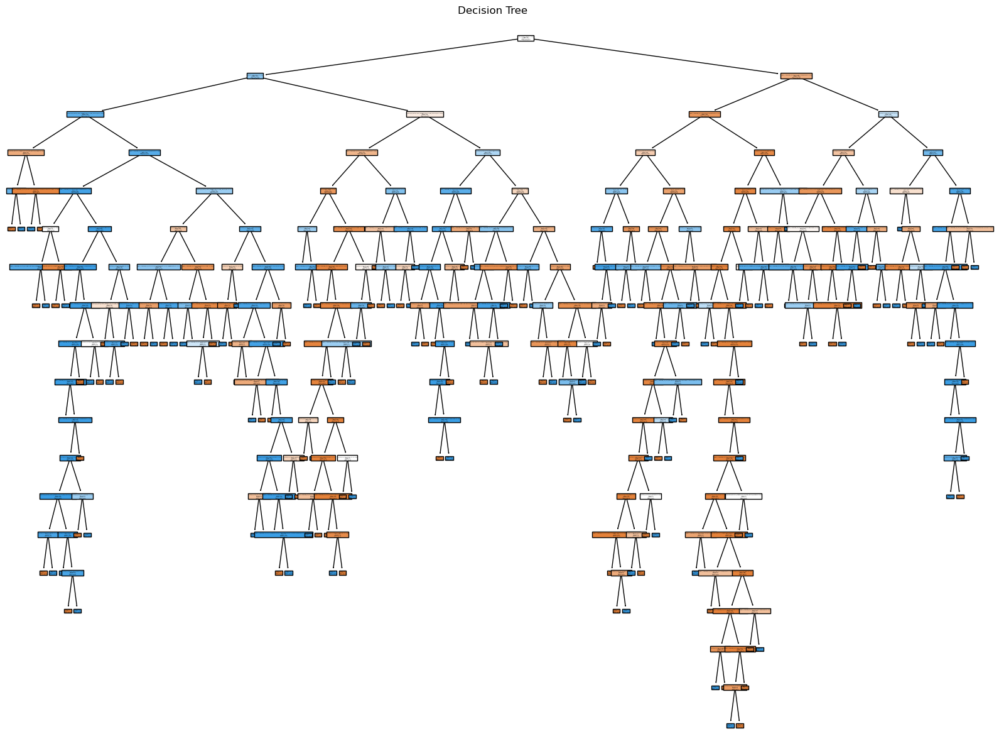

In [92]:
# plot the decision tree 
# convert column index to a list of feature names
tree_feature_names = pd.DataFrame(X_test_pca).columns.tolist()


# Plot the decision tree
plt.figure(figsize=(20, 15))  
plot_tree(tree_clf, filled=True, feature_names=tree_feature_names, class_names=['Class 0', 'Class 1'])
plt.title("Decision Tree")
plt.show()

In [93]:
# define the hyperparameter grid for Decision Tree
param_grid = {
    'criterion': ['gini', 'entropy'],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
}

# create a new Decision Tree classifier
tree_clf = tree.DecisionTreeClassifier()  

# perform grid search with cross-validation and fit to data
grid_search = GridSearchCV(tree_clf, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train, y_train)

# get the best parameters and best estimator
best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_

print("Best Parameters:", best_params)
print("Best Estimator:", best_estimator)

Best Parameters: {'criterion': 'gini', 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2}
Best Estimator: DecisionTreeClassifier()


In [95]:
# build and fir moel w/ best estimator 
tree_clf = tree.DecisionTreeClassifier()  
tree_clf.fit(X_train_resampled, y_train_resampled)  

# predict on test data 
tree_pred = tree_clf.predict(X_valid_pca)
tree_prob = log_reg.predict_proba(X_valid_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_valid, tree_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

tree_2_specificity = tn / (tn + fp)
tree_2_sensitivity = tp / (tp + fn)
tree_2_f1 = f1_score(y_valid, tree_pred, pos_label='Intentional Use of Force, Deadly')  
tree_2_acc = accuracy_score(y_valid, tree_pred)
tree_roc2_auc = roc_auc_score(y_valid, tree_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", tree_2_acc)
print("Specificity:", tree_2_specificity)
print("Sensitivity (Recall):", tree_2_sensitivity)
print("F1 Score:", tree_2_f1)
print("ROC-AUC Score:", tree_roc2_auc)

Test Set Metrics
Confusion Matrix:
[[570  87]
 [ 58 195]]
Accuracy: 0.8406593406593407
Specificity: 0.867579908675799
Sensitivity (Recall): 0.7707509881422925
F1 Score: 0.8871595330739299
ROC-AUC Score: 0.9642163144247717


In [96]:
# calculate permutation importance
perm_importance = permutation_importance(tree_clf, X_test_pca, y_test,
                                         n_repeats=30, random_state=42)

# get the importances and indices of features
importances = perm_importance.importances_mean
feature_indices = np.argsort(importances)[::-1]

# get the original column names from X_train
original_column_names = X_train_resampled.columns

# create a DataFrame to store the importance of each feature
importance_df = pd.DataFrame({'Feature': original_column_names[feature_indices],
                              'Importance': importances[feature_indices]})

# display top 10 feature importance 
top_10_importance_df = importance_df.head(10)
top_10_importance_df

,Feature,Importance
0,Cause_of_death_Vehicle,0.105604
1,Agency_responsible_for_death_Dinuba Police Dep...,0.058278
2,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_...",0.048681
3,Subjects_gender_Female,0.044908
4,Agency_responsible_for_death_Oakland Police De...,0.044762
5,Location_of_death_(county)_Placer,0.012967
6,Location_of_death_(county)_Santa Barbara,0.010586
7,Cause_of_death_Drowned,0.009597
8,Agency_responsible_for_death_San Joaquin Count...,0.009121
9,Location_of_death_(city)_Gilroy,0.007985


### Random Forest 

In [97]:
# define Random Forest Classifier and fit to data 
rf_clf = RandomForestClassifier(random_state=42)
rf_clf.fit(X_train_resampled, y_train_resampled)

# predict on training data 
rf_pred = rf_clf.predict(X_train_resampled)
rf_prob = rf_clf.predict_proba(X_train_resampled)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_train_resampled, rf_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

rf_specificity = tn / (tn + fp)
rf_sensitivity = tp / (tp + fn)
rf_f1 = f1_score(y_train_resampled, rf_pred, pos_label='Intentional Use of Force, Deadly') 
rf_acc = accuracy_score(y_train_resampled, rf_pred)
rf_roc_auc = roc_auc_score(y_train_resampled, rf_prob)

print ("Train Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", rf_acc)
print("Specificity:", rf_specificity)
print("Sensitivity (Recall):", rf_sensitivity)
print("F1 Score:", rf_f1)
print("ROC-AUC Score:", rf_roc_auc)

Train Set Metrics
Confusion Matrix:
[[2011    0]
 [   0 2011]]
Accuracy: 1.0
Specificity: 1.0
Sensitivity (Recall): 1.0
F1 Score: 1.0
ROC-AUC Score: 1.0


In [98]:
# define the hyperparameter grid for Random Forest
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False],
}

# create a new Random Forest classifier
rf_clf = RandomForestClassifier(random_state=42)

# perform grid search with cross-validation and fit to data
grid_search = GridSearchCV(rf_clf, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train, y_train)

# get the best parameters and best estimator
best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_

print("Best Parameters:", best_params)
print("Best Estimator:", best_estimator)

Best Parameters: {'bootstrap': False, 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 300}
Best Estimator: RandomForestClassifier(bootstrap=False, min_samples_split=5, n_estimators=300,
                       random_state=42)


In [99]:
# build and fit rf classifier using best parameters
rf_clf = RandomForestClassifier(bootstrap=False, 
                                min_samples_split=5, 
                                n_estimators=300,
                                random_state=42)

rf_clf.fit(X_train_resampled, y_train_resampled)

# predict on the test set            
rf_pred = rf_clf.predict(X_valid_pca)
rf_prob = rf_clf.predict_proba(X_valid_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_valid, rf_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

rf_2_specificity = tn / (tn + fp)
rf_2_sensitivity = tp / (tp + fn)
rf_2_f1 = f1_score(y_valid, rf_pred, pos_label='Intentional Use of Force, Deadly')  
rf_2_acc = accuracy_score(y_valid, rf_pred)
rf_roc2_auc = roc_auc_score(y_valid, rf_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", rf_2_acc)
print("Specificity:", rf_2_specificity)
print("Sensitivity (Recall):", rf_2_sensitivity)
print("F1 Score:", rf_2_f1)
print("ROC-AUC Score:", rf_roc2_auc)

Test Set Metrics
Confusion Matrix:
[[626  31]
 [ 73 180]]
Accuracy: 0.8857142857142857
Specificity: 0.9528158295281582
Sensitivity (Recall): 0.7114624505928854
F1 Score: 0.9233038348082595
ROC-AUC Score: 0.9495490942780996


In [101]:
# variable importance plot
importances = rf_clf.feature_importances_
std = np.std([tree.feature_importances_ for tree in rf_clf.estimators_], axis=0)
importance_df = pd.DataFrame({'feature': X_train_resampled.columns, 'importance': importances, 'std': std})
importance_df = importance_df.sort_values('importance')

# display top 10 feature importance 
top_10_importance_df = importance_df.head(10)
top_10_importance_df

,feature,importance,std
597,Location_of_death_(city)_Fairfield,0.000330,0.001034
608,Agency_responsible_for_death_Los Angeles Count...,0.000344,0.000868
652,Location_of_death_(city)_Garden Valley,0.000351,0.001132
546,Agency_responsible_for_death_Seaside Police De...,0.000382,0.001149
526,Location_of_death_(city)_Mecca,0.000396,0.001020
607,Location_of_death_(city)_San Miguel,0.000422,0.001031
514,Agency_responsible_for_death_Lindsay Departmen...,0.000429,0.001297
628,Location_of_death_(city)_Hesperia,0.000431,0.001107
480,Location_of_death_(city)_Rancho Santa Margarita,0.000444,0.001060
500,Agency_responsible_for_death_Riverside County ...,0.000448,0.001142


In [102]:
# Probability of class 1
rf_predicted_probabilities = rf_clf.predict_proba(X_test_pca)[:, 1]  

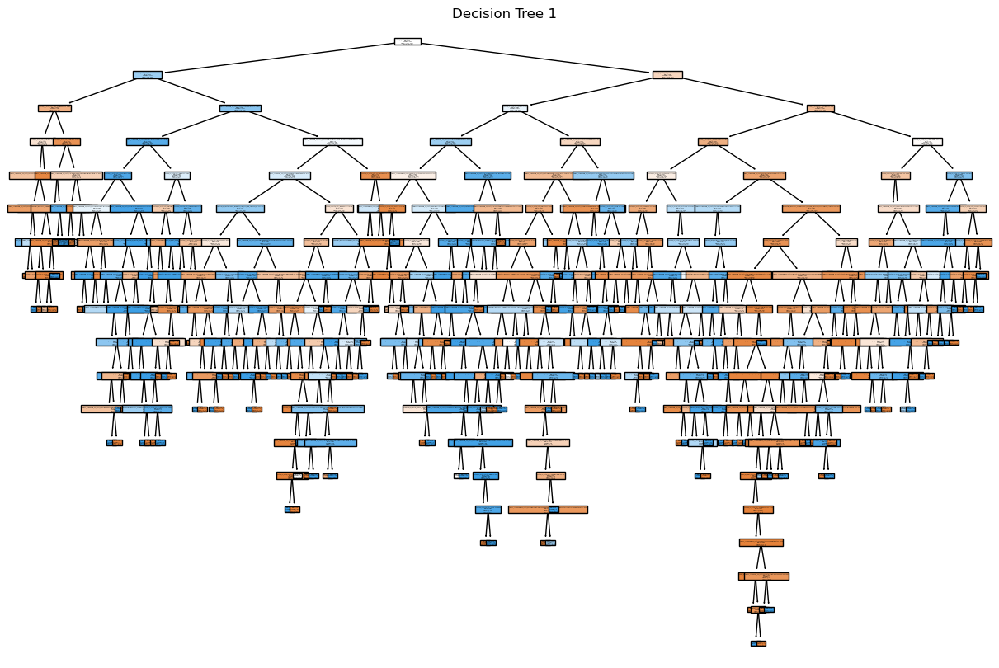

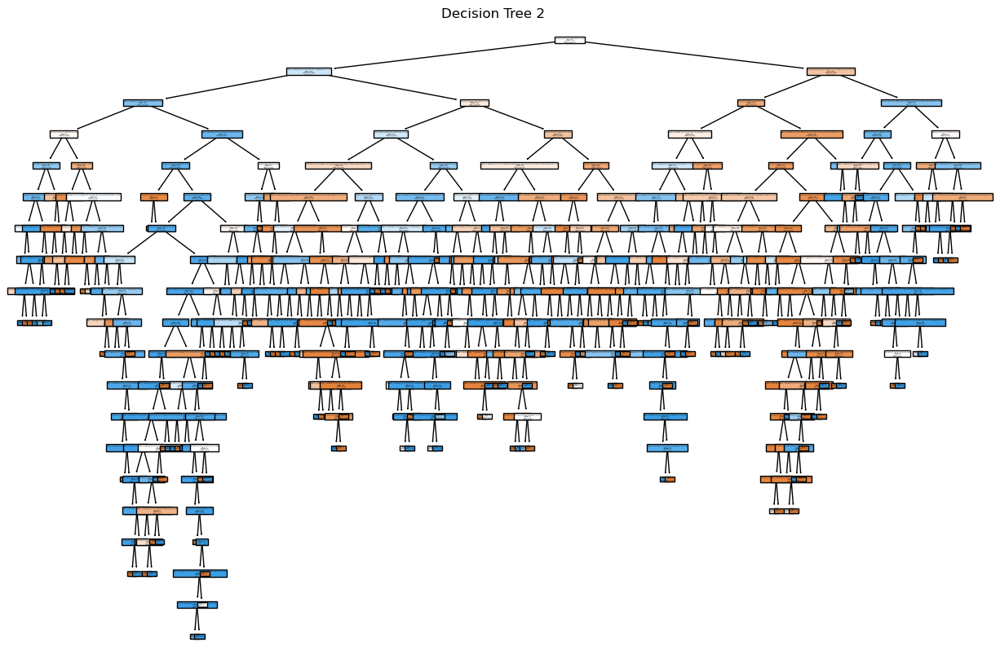

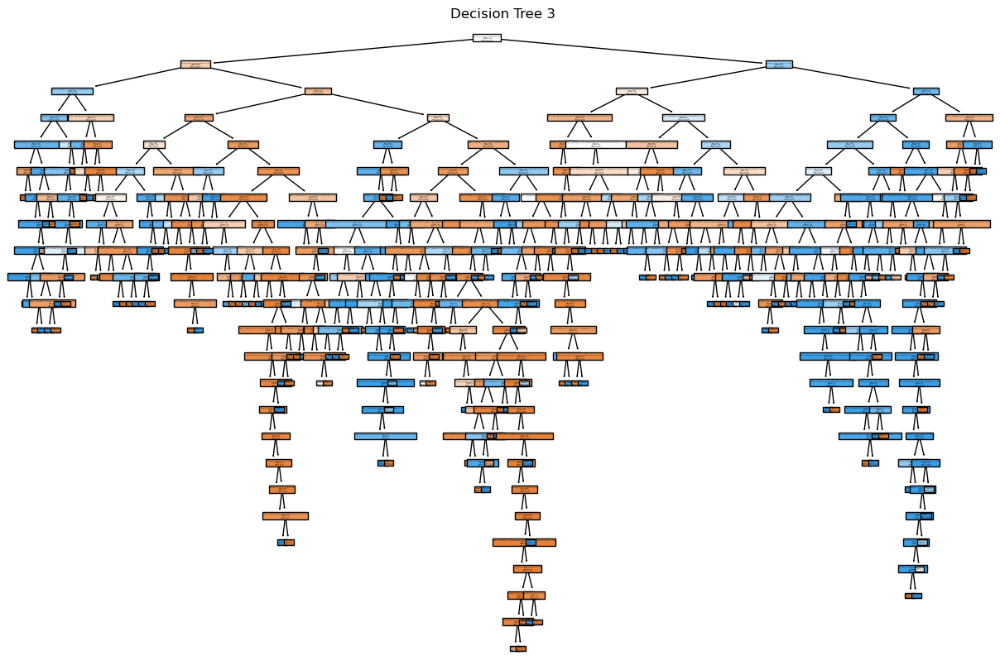

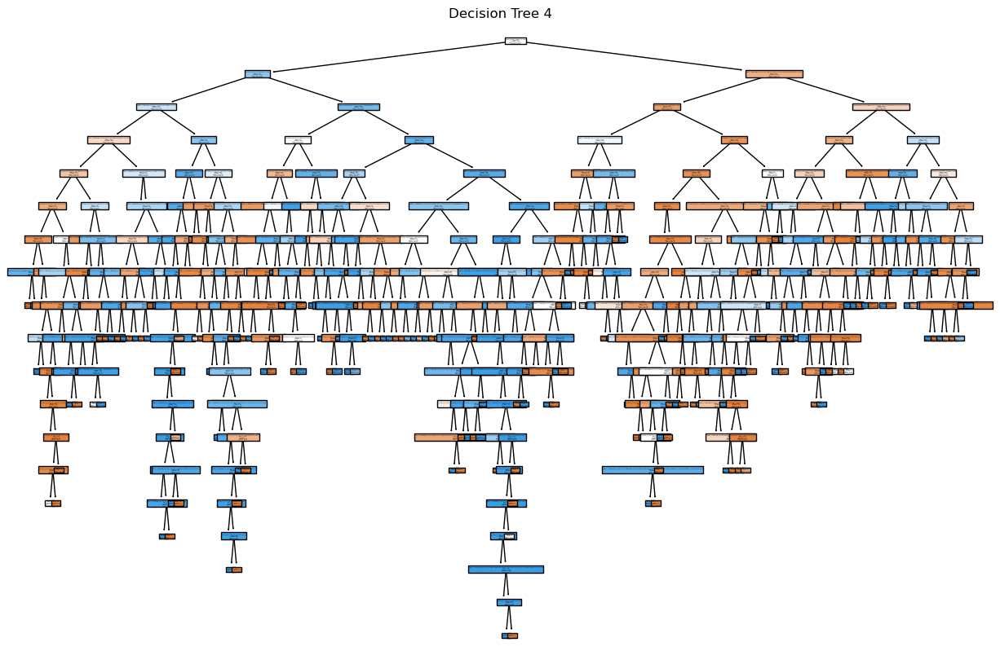

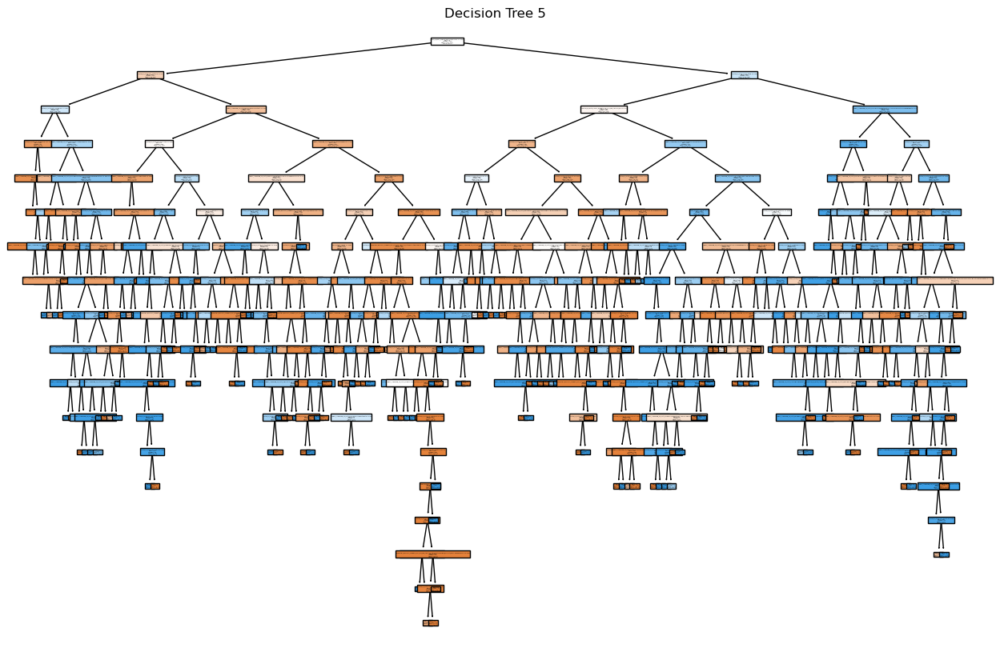

In [103]:
# Get the individual decision trees from the Random Forest
individual_trees = rf_clf.estimators_[:5]  # Slice the first 5 trees

# Convert feature names to a list
rf_feature_names = pd.DataFrame(X_train_resampled).columns.tolist()

# Plot each tree
for i, tree in enumerate(individual_trees):
    plt.figure(figsize=(15, 10))  
    plot_tree(tree, filled=True, feature_names=rf_feature_names, class_names=['Class 0', 'Class 1'])
    plt.title(f"Decision Tree {i+1}")
    plt.show()

## Results

In [104]:
# displaying all reuslts in a df 

# create lists to store the scores
models = ["Neural Network", "Naive Bayes", "Gradient Boosting", "Linear Discriminant Analysis",
              "Logistic Regression", "Random Forest", "Decision Tree"]
accuracies = [nn_2_acc, nb_2_acc, gb_2_acc, lda_2_acc, log_2_acc, rf_2_acc, tree_2_acc]
specificities = [nn_2_specificity, nb_2_specificity, gb_2_specificity, lda_2_specificity
                , log_2_specificity, rf_2_specificity,  tree_2_specificity]
sensitivities = [nn_2_sensitivity, nb_2_sensitivity, gb_2_sensitivity, lda_2_sensitivity,
                 log_2_sensitivity, rf_2_sensitivity,  tree_2_sensitivity]
f1_scores = [nn_2_f1, nb_2_f1, gb_2_f1, lda_2_f1, log_2_f1, rf_2_f1, tree_2_f1]
roc_auc = [nn_roc2_auc, nb_roc2_auc, gb_roc2_auc, lda_roc2_auc, log_roc2_auc, rf_roc2_auc,tree_roc2_auc]

# create df
scores_df = pd.DataFrame({
    "Model": models,
    "Accuracy": accuracies,
    "Specificity": specificities,
    "Sensitivity (Recall)": sensitivities,
    "F1 Score": f1_scores,
    "ROC - AUC Score": roc_auc 
})

scores_df

,Model,Accuracy,Specificity,Sensitivity (Recall),F1 Score,ROC - AUC Score
0,Neural Network,0.948352,0.960426,0.916996,0.964095,0.974329
1,Naive Bayes,0.389011,0.267884,0.703557,0.387665,0.478116
2,Gradient Boosting,0.950549,0.977169,0.881423,0.966140,0.984900
3,Linear Discriminant Analysis,0.951648,0.961948,0.924901,0.966361,0.984190
4,Logistic Regression,0.951648,0.957382,0.936759,0.966206,0.964216
5,Random Forest,0.885714,0.952816,0.711462,0.923304,0.949549
6,Decision Tree,0.840659,0.867580,0.770751,0.887160,0.964216


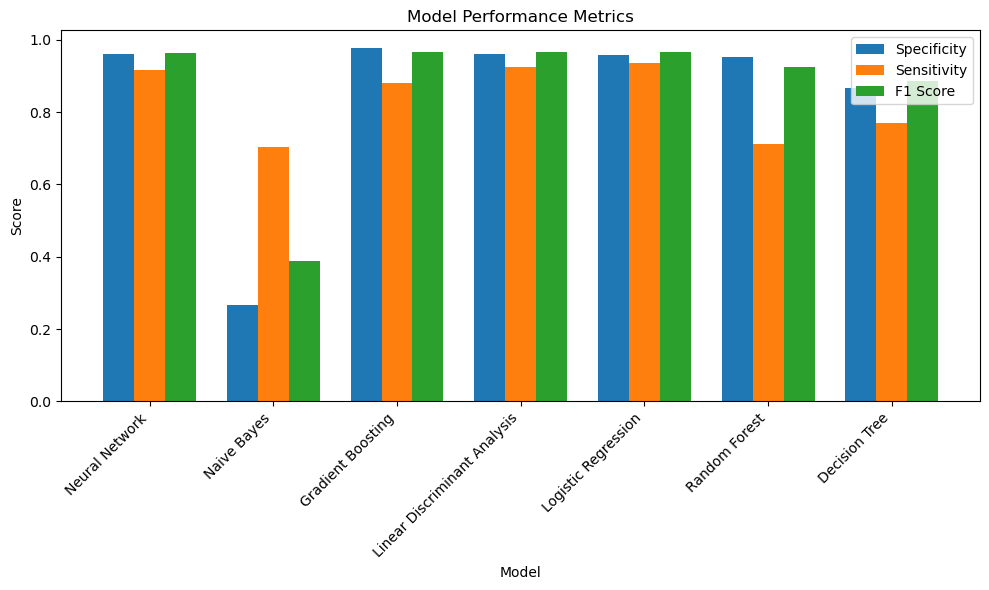

In [105]:
# define the data/set up for altered models
models = scores_df['Model']
specificity = scores_df['Specificity']
sensitivity = scores_df['Sensitivity (Recall)']
f1_score = scores_df['F1 Score']

x = np.arange(len(models))  # set x-coordiantes
width = 0.25

# create grouped bar plot
fig, ax = plt.subplots(figsize=(10, 6))
rects1 = ax.bar(x - width, specificity, width, label='Specificity')
rects2 = ax.bar(x, sensitivity, width, label='Sensitivity')
rects3 = ax.bar(x + width, f1_score, width, label='F1 Score')

# add labels, title, legend
ax.set_xlabel('Model')
ax.set_ylabel('Score')
ax.set_title('Model Performance Metrics')
ax.set_xticks(x)
ax.set_xticklabels(models, rotation=45, ha='right')
ax.legend()


plt.tight_layout()
plt.show()

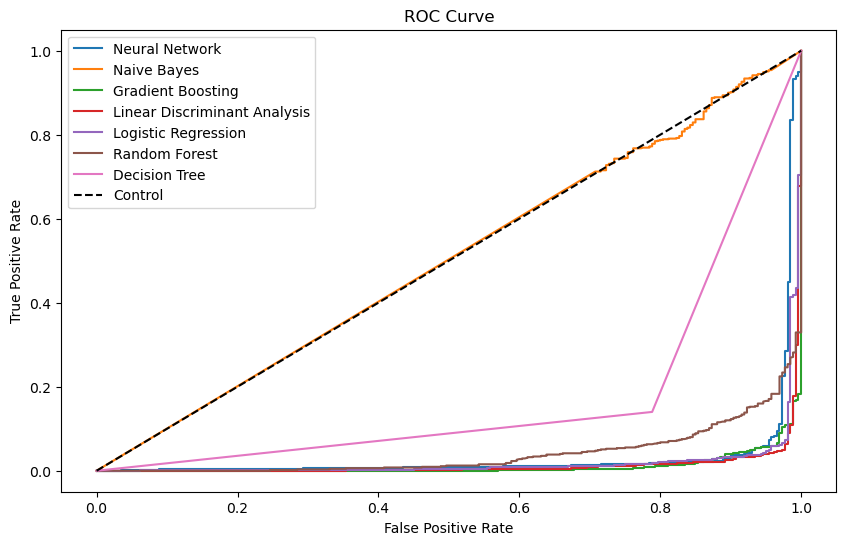

In [106]:
# create lists to store the scores
models = ["Neural Network", "Naive Bayes", "Gradient Boosting", "Linear Discriminant Analysis",
              "Logistic Regression", "Random Forest", "Decision Tree"]
y_scores = [nn_clf.predict_proba(X_test_pca)[:, 1],
            nb_clf.predict_proba(X_test_pca)[:, 1],
            gb_clf.predict_proba(X_test_pca)[:, 1],
            lda_clf.predict_proba(X_test_pca)[:, 1],
            log_reg.predict_proba(X_test_pca)[:, 1],
            rf_clf.predict_proba(X_test_pca)[:, 1],
            tree_clf.predict_proba(X_test_pca)[:, 1]]

# plot ROC curves for each model
positive_class = 'Intentional Use of Force, Deadly'  # define positive class

# create binary mask ( positive = 1, other = 0)
y_binary = (y_test == positive_class).astype(int)

# plot ROC curves for each model
plt.figure(figsize=(10, 6))
for model, scores in zip(models, y_scores):
    fpr, tpr, thresholds = roc_curve(y_binary, scores)
    auc = roc_auc_score(y_binary, scores)
    plt.plot(fpr, tpr, label=f"{model}")


# plot the diagonal line - control
plt.plot([0, 1], [0, 1], 'k--', label='Control')

# display the plot
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend()
plt.show()

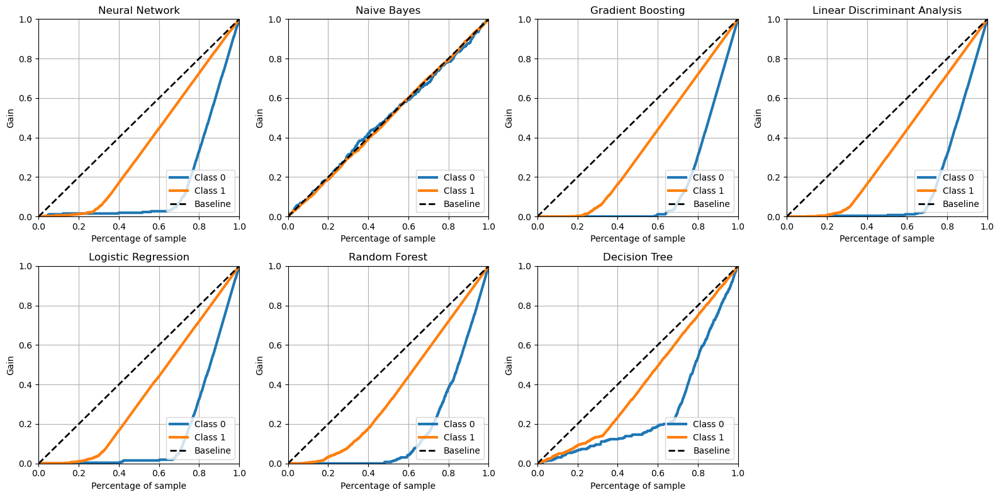

In [107]:
# create subplots for cumulative gain charts
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(16, 8))
for ax, model_name, y_score in zip(axes.flat, models, y_scores):
    y_scores_2d = np.column_stack((1 - y_score, y_score))
    plot_cumulative_gain(y_binary, y_scores_2d, title=model_name, ax=ax)

# remove empty subplots
for i in range(len(models), 2 * 4):
    fig.delaxes(axes.flat[i])

plt.tight_layout()
plt.show()

Based on the evaluation of various machine learning models and considering the specific goals outlined in the problem statement, Logistic Regression emerges as a strong contender for the task at hand.

Logistic Regression showcases a well-balanced performance in terms of sensitivity, specificity, F1 score, and ROC-AUC score, which are vital for the goal of identifying cases that require additional resources during emergency responses. This model's higher sensitivity indicates its ability to accurately detect cases in need of such resources, aligning with the mission of our nonprofit group. 

Moreover, Logistic Regression's interpretability allows for a better understanding of the underlying factors influencing classification decisions, which can aid in justifying resource allocation and officer training. Its efficiency in terms of computation and memory makes it a practical choice for real-time or large-scale applications. While model selection depends on specific requirements and constraints, Logistic Regression appears well-suited to address the critical task of improving public safety and law enforcement effectiveness through data-driven insights.

## Test on Elected Model - Logistic Regression

In [110]:
from sklearn.metrics import f1_score
# predict on the test set            
log_pred = log_reg.predict(X_test_pca)
log_prob = log_reg.predict_proba(X_test_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_test, log_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

specificity = tn / (tn + fp)
sensitivity = tp / (tp + fn)
f1 = f1_score(y_test, log_pred, pos_label='Intentional Use of Force, Deadly')  
acc = accuracy_score(y_test, log_pred)
roc_auc = roc_auc_score(y_test, log_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", acc)
print("Specificity:", specificity)
print("Sensitivity (Recall):", sensitivity)
print("F1 Score:", f1)
print("ROC-AUC Score:", roc_auc)

Test Set Metrics
Confusion Matrix:
[[624  26]
 [ 14 246]]
Accuracy: 0.9560439560439561
Specificity: 0.96
Sensitivity (Recall): 0.9461538461538461
F1 Score: 0.968944099378882
ROC-AUC Score: 0.981905325443787


In [116]:
# put it together in a data frame
log_result = pd.DataFrame({
    'actual': y_test,
    'p(0)': 1 - log_prob,  # Probability for the negative class
    'p(1)': log_prob,  # Probability for the positive class
    'predicted': log_pred
})

log_result.head()

,actual,p(0),p(1),predicted
1831,"Intentional Use of Force, Deadly",0.990519,0.009481,"Intentional Use of Force, Deadly"
495,"Unintentional Use of Force, Deadly",0.032066,0.967934,"Unintentional Use of Force, Deadly"
2877,"Intentional Use of Force, Deadly",0.961614,0.038386,"Intentional Use of Force, Deadly"
1467,"Intentional Use of Force, Deadly",0.982932,0.017068,"Intentional Use of Force, Deadly"
1760,"Intentional Use of Force, Deadly",0.969146,0.030854,"Intentional Use of Force, Deadly"


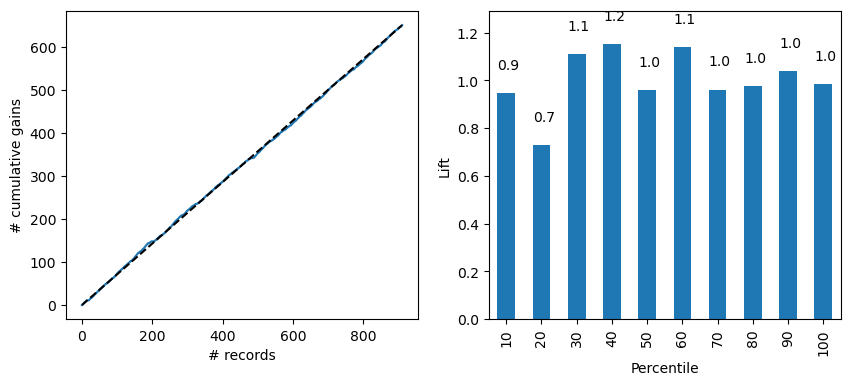

In [117]:
# Convert the 'actual' column to binary (0 or 1)
log_result['actual'] = (log_result['actual'] == 'Intentional Use of Force, Deadly').astype(int)

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 4))

gainsChart(log_result['actual'], ax=axes[0])
liftChart(log_result['p(1)'], title=False, ax=axes[1]);